<p style="font-family: Times New Roman;font-size:22px;color:orangered"><b>1. Introduction</b></p>

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>1.1. Import the necessary libraries.</b></p>

In [1]:
# For network analysis
import networkx as nx
import community

# For plotting graphs
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.lines as mlines
import matplotlib.patches as mpatches

# For importing files, handling dataframes and functions
import pandas as pd
import numpy as np
import math
import random

# Conda environments management (Import sna.yml)
#conda env create -f sna.yml
#conda activate sna

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>1.2. Load and quickly inspect the two files.</b></p>

In [15]:
# Load the node file into a pandas DataFrame
nodes_df = pd.read_csv("nodes_cluster_G.csv", delimiter=';', header=0)
print(nodes_df.head())
print('===='*10)
# Load the edge file into a pandas DataFrame
edges_df = pd.read_csv('edges_cluster_G.csv', delimiter=';', header=0)
print(edges_df.head())

      id  coord  core  gender
0  12948      0     0       0
1   8295      0     1       0
2  12924      0     0       1
3  12925      0     1       0
4   7440      1     1       0
   source  target  pre_link  post_link
0   69531    2682         1          0
1   12948    2682         1          0
2    7440    2682         1          0
3   54391    2682         1          0
4   12937    2682         1          0


In [20]:
#Simple view
print(nodes_df.dtypes)
print('=='*10)
print(edges_df.dtypes)

id        int64
coord     int64
core      int64
gender    int64
dtype: object
source       int64
target       int64
pre_link     int64
post_link    int64
dtype: object


<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>1.3. Create the graph.</b></p>

In [6]:
#Create a NetworkX graph
G = nx.Graph()

# Add nodes to the graph
for _, row in nodes_df.iterrows():
    G.add_node(row['id'], coord=row['coord'], core=row['core'], gender=row['gender'])

# Add edges to the graph
for _, row in edges_df.iterrows():
    G.add_edge(row['source'], row['target'], pre_link=row['pre_link'], post_link=row['post_link'])

# Print graph summary
print('Graph with', G.number_of_nodes(), 'nodes and', G.number_of_edges(), 'edges.')

Graph with 381 nodes and 2098 edges.


<p style="font-family: Times New Roman;font-size:22px;color:orangered"><b>3. Separated time periods</b></p>

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>3.1. Time analysis: pre and post treatment.</b></p>

In [19]:
# Select source, target, pre_link
edges_df_PRE = edges_df.iloc[:, :3]
# Select source, target, post_link
edges_df_POST = edges_df.iloc[:, [0, 1, 3]]

#Create NetworkX graphs
PRE = nx.Graph()
POST = nx.Graph()

# Add nodes to the graphs
for _, row in nodes_df.iterrows():
    PRE.add_node(row['id'], coord=row['coord'], core=row['core'], gender=row['gender'])
for _, row in nodes_df.iterrows():
    POST.add_node(row['id'], coord=row['coord'], core=row['core'], gender=row['gender'])

# Add edges to the graph where pre_link=1
for _, row in edges_df_PRE[edges_df_PRE['pre_link'] == 1].iterrows():
    PRE.add_edge(row['source'], row['target'], pre_link=row['pre_link'])
# Add edges to the graph where post_link=1
for _, row in edges_df_POST[edges_df_POST['post_link'] == 1].iterrows():
    POST.add_edge(row['source'], row['target'], post_link=row['post_link'])

# Print graph summary
print('Graph PRE with', PRE.number_of_nodes(), 'nodes and', PRE.number_of_edges(), 'edges.')
# Check if the graph is connected or disconnected
print("Is the graph connected?", nx.is_connected(PRE))
# Print graph summary
print('Graph POST with', POST.number_of_nodes(), 'nodes and', POST.number_of_edges(), 'edges.')
# Check if the graph is connected or disconnected
print("Is the graph connected?", nx.is_connected(POST))

Graph PRE with 381 nodes and 1251 edges.
Is the graph connected? False
Graph POST with 381 nodes and 1440 edges.
Is the graph connected? False


<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>3.2. Pre treatment.</b></p>

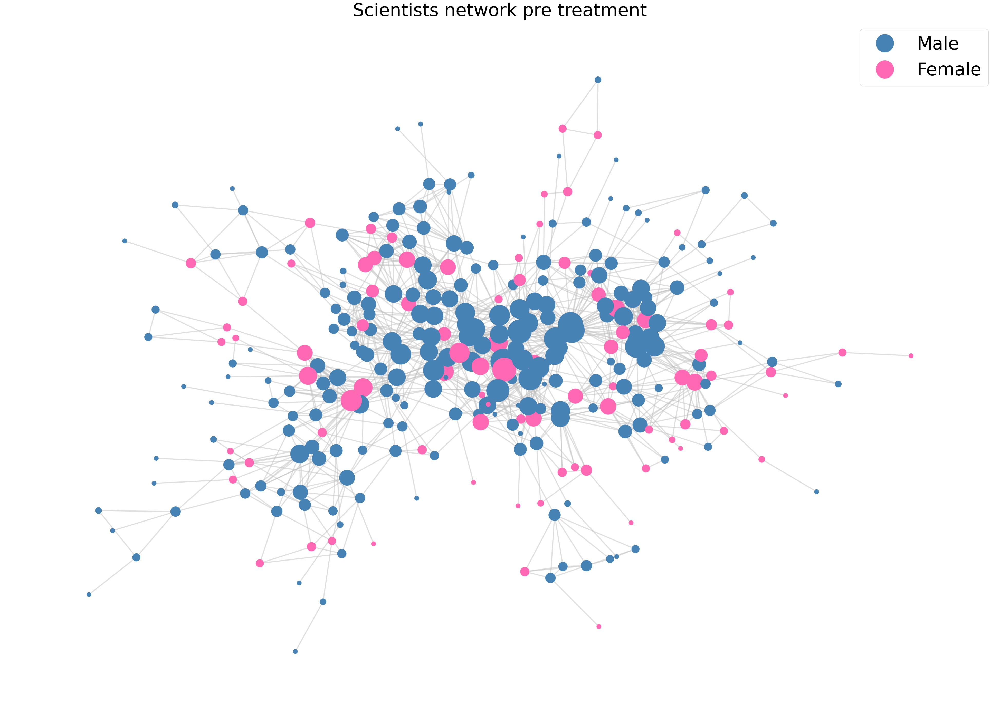

In [20]:
# Choose layout
pos = nx.kamada_kawai_layout(PRE)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in PRE.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in PRE.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(PRE, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in PRE.nodes()])

# Draw the edges
nx.draw_networkx_edges(PRE, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Scientists network pre treatment', fontsize=50)
plt.show()

#plt.savefig('figures/scientists_network_pre.png',format='png')

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>3.2.3. Cluster coordinator PRE.</b></p>

In [29]:
# Find nodes with attribute coord=1
node_coord_PRE = [n for n, attrs in PRE.nodes(data=True) if attrs['coord'] == 1]
print('The cluster coordinator is node',node_coord_PRE)

# Change the color of coordinator node
nx.set_node_attributes(PRE, {7440: 'darkorange'}, name='color')

# Find coordinator node' gender
if PRE.nodes[7440]['gender'] == 0:
    print('The cluster coordinator is male.')
else:
    print('The cluster coordinator is female.')

neighbors_7440_PRE = list(PRE.neighbors(7440))
print("Neighbors of node 7440:", neighbors_7440_PRE)

# Create a subgraph with node 7440 and its neighbors
CD_PRE = PRE.subgraph([7440] + neighbors_7440_PRE)

# Check if the graph is connected or disconnected
print("Is the graph connected?", nx.is_connected(CD_PRE))

The cluster coordinator is node [7440]
The cluster coordinator is male.
Neighbors of node 7440: [2682, 7431, 7444, 7442, 36875, 73243, 85068, 54368, 36856, 36853, 7447, 61474, 12937, 36854, 36886, 36885, 82797, 60719, 8295, 7452]
Is the graph connected? True


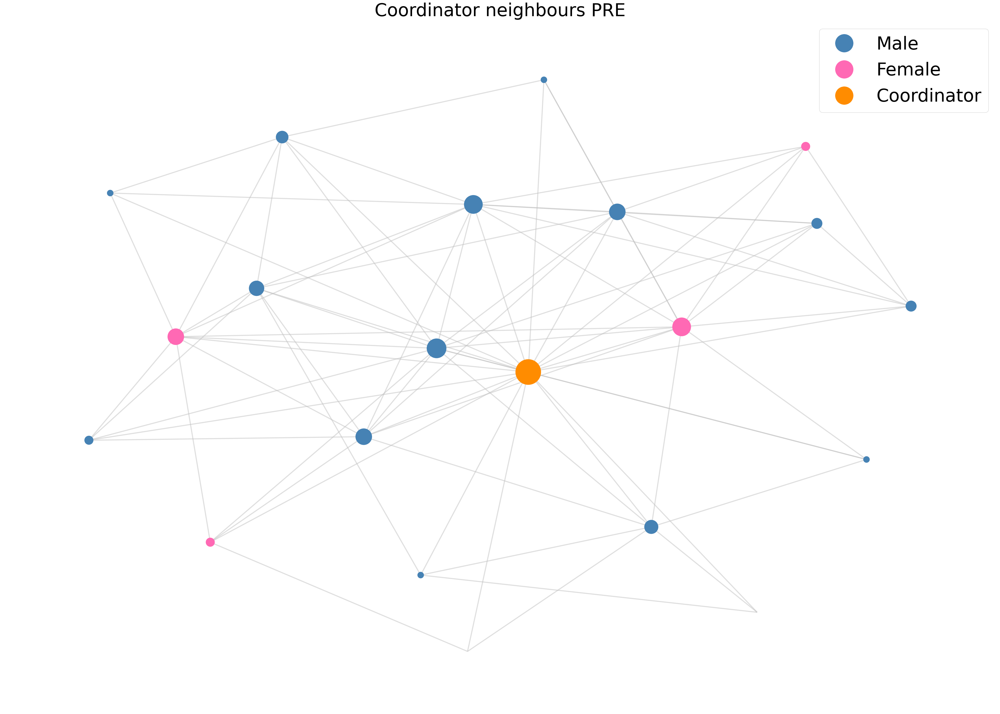

In [30]:
#Create a temporary gender value, for color mapping purposes
PRE.nodes[7440]['gender'] = 2

# Choose layout
pos = nx.kamada_kawai_layout(CD_PRE)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink', 2:'darkorange'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in PRE.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in CD_PRE.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(CD_PRE, pos, node_size=[v for v in degrees],
                      node_color=[node_color_map.get(str(n)) for n in CD_PRE.nodes()])

# Draw the edges
nx.draw_networkx_edges(CD_PRE, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female', 'Coordinator'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Coordinator neighbours PRE', fontsize=50)
plt.show()
#plt.savefig('coordinator_pre.png')

# Restore node 7440 manhood
PRE.nodes[7440]['gender'] = 0

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>3.2.3.1. Centrality measures for coordinator node PRE.</b></p>

In [31]:
print(f"Degree of cluster coordinator: {PRE.degree(7440)}.")
print("Clustering coefficient of cluster coordinator:", nx.clustering(PRE, 7440))

Degree of cluster coordinator: 20.
Clustering coefficient of cluster coordinator: 0.3157894736842105


In [32]:
closeness_centrality_PRE = nx.closeness_centrality(PRE)
closeness_centrality_7440_PRE = closeness_centrality_PRE[7440]
print("Closeness centrality of the coordinator PRE:", closeness_centrality_7440_PRE)

eigenvector_centrality_PRE = nx.eigenvector_centrality(PRE)
eigenvector_centrality_7440_PRE = eigenvector_centrality_PRE[7440]
print("Eigenvector centrality of the coordinator PRE:", eigenvector_centrality_7440_PRE)

betweenness_centrality_PRE = nx.betweenness_centrality(PRE)
betweenness_centrality_7440_PRE = betweenness_centrality_PRE[7440]
print("Betweenness centrality of the coordinator PRE:", betweenness_centrality_7440_PRE)

Closeness centrality of the coordinator PRE: 0.25439330543933053
Eigenvector centrality of the coordinator PRE: 0.1443175663103226
Betweenness centrality of the coordinator PRE: 0.016138404913978336


<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>3.2.3.2. Gender distribution into coordinator cluster PRE.</b></p>

In [33]:
num_male_coord_ditrib_PRE = 0
num_female_coord_ditrib_PRE = 0

for node_id, node_attr in CD_PRE.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_coord_ditrib_PRE += 1
    elif node_attr['gender'] == 1:
        num_female_coord_ditrib_PRE += 1

print("Number of male nodes PRE:", num_male_coord_ditrib_PRE)
print("Number of female nodes PRE:", num_female_coord_ditrib_PRE)

Number of male nodes PRE: 17
Number of female nodes PRE: 4


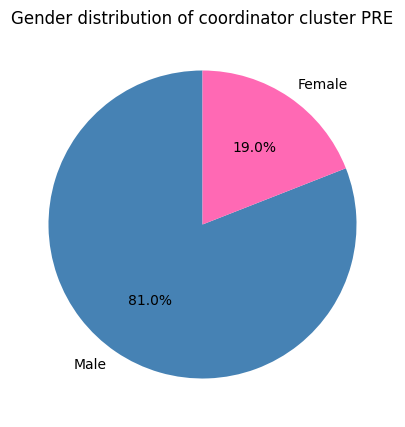

In [34]:
# Define the data
labels_coord_ditrib = ['Male', 'Female']
sizes_coord_distrib_PRE = [num_male_coord_ditrib_PRE, num_female_coord_ditrib_PRE]
colors_coord_distrib = ['steelblue', 'hotpink']

# Create the pie chart
fig, ax = plt.subplots(figsize=(10, 5))
plt.pie(sizes_coord_distrib_PRE, labels=labels_coord_ditrib, colors=colors_coord_distrib, autopct='%1.1f%%', startangle=90)

# Add a title
plt.title('Gender distribution of coordinator cluster PRE')

# Display the chart
plt.show()

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>3.3. Post treatment.</b></p>

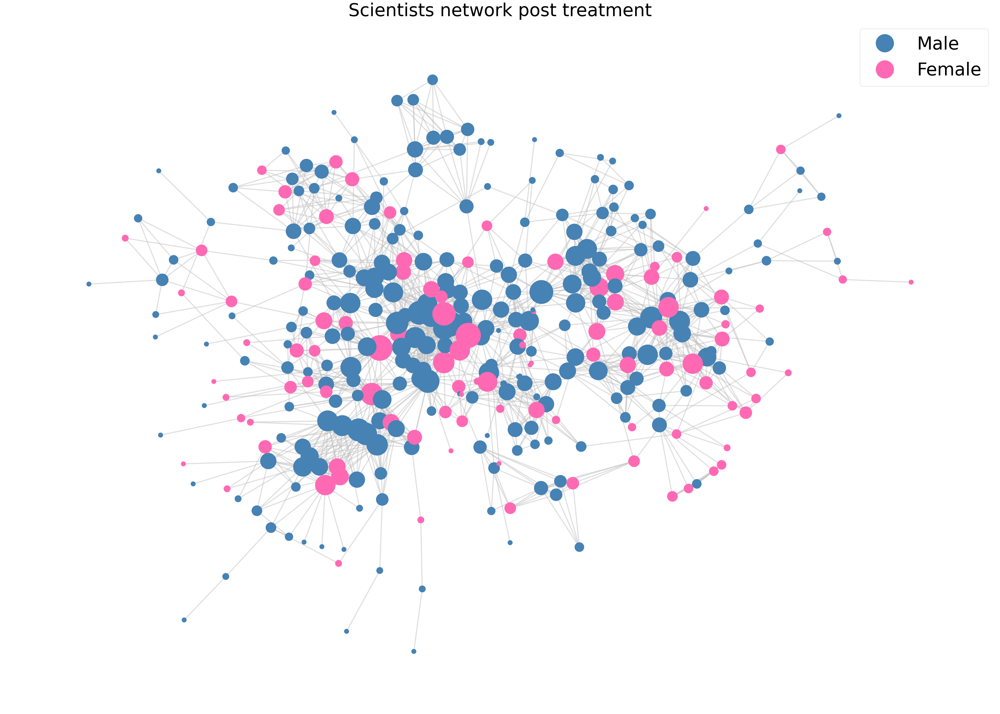

In [35]:
# Choose layout
pos = nx.kamada_kawai_layout(POST)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in POST.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in POST.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(POST, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in POST.nodes()])

# Draw the edges
nx.draw_networkx_edges(POST, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Scientists network post treatment', fontsize=50)
plt.show()
#plt.savefig('figures/scientists_network_connected.svg',format='svg')

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>3.3.1. Male graph POST.</b></p>

In [36]:
# Get the nodes representing male scientists
male_nodes_POST = [n for n, d in POST.nodes(data=True) if d['gender'] == 0]

# Create a subgraph containing only these nodes
M_POST = POST.subgraph(male_nodes_POST)

print('Graph with', M_POST.number_of_nodes(),'nodes and', M_POST.number_of_edges(), 'edges.')
print('Is the graph connected?',nx.is_connected(M_POST))

Graph with 271 nodes and 745 edges.
Is the graph connected? False


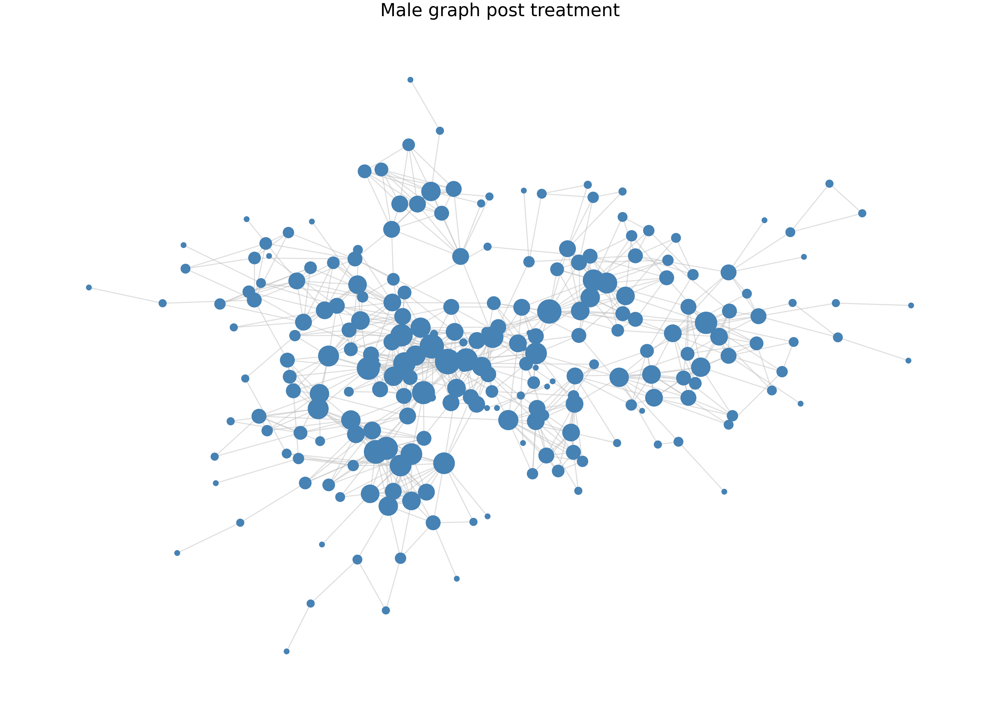

In [37]:
# Choose layout
pos = nx.kamada_kawai_layout(M_POST)

# Get the degree list 
degrees = [d for n,d in M_POST.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(M_POST, pos, node_size=[v for v in degrees], node_color='steelblue')

# Draw the edges
nx.draw_networkx_edges(M_POST, pos, edge_color='silver', width=3.0, alpha=0.5)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Male graph post treatment', fontsize=50)
plt.show()
# plt.savefig('figures/male_graph_post.svg', format='svg')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>3.3.1.1. Male graph POST averages.</b></p>

In [38]:
# Average nodes' degree 
avg_degree_M_POST = sum([degree for node, degree in M_POST.degree()])/M_POST.number_of_nodes()
print('Average degree Male post: ' + str(avg_degree_M_POST))

# Average local clustering coefficient
avg_clust_M_POST = nx.average_clustering(M_POST)
print('Average clustering coefficient Male post:', avg_clust_M_POST)

# Global clustering coefficient (transitivity)
transv_M_POST = nx.transitivity(M_POST)
print('Transitivity Male post:', transv_M_POST)

Average degree Male post: 5.498154981549815
Average clustering coefficient Male post: 0.40945263125583675
Transitivity Male post: 0.46031000469704086


In [39]:
#Average closeness centrality
closeness_M_POST = nx.closeness_centrality(M_POST)
avg_closeness_M_POST = sum(closeness_M_POST.values()) / len(closeness_M_POST)
print("Average closeness centrality Male post:", avg_closeness_M_POST)

#Average eigenvector centrality
eigenvector_M_POST = nx.eigenvector_centrality(M_POST, max_iter=1000)
avg_eigenvector_M_POST = sum(eigenvector_M_POST.values()) / len(eigenvector_M_POST)
print("Average eigenvector centrality Male post:", avg_eigenvector_M_POST)

#Average betweenness centrality
betweenness_M_POST = nx.betweenness_centrality(M_POST)
avg_betweenness_M_POST = sum(betweenness_M_POST.values()) / len(betweenness_M_POST)
print("Average betweenness centrality Male post:", avg_betweenness_M_POST)

Average closeness centrality Male post: 0.14147717162857323
Average eigenvector centrality Male post: 0.031518866392657
Average betweenness centrality Male post: 0.007436163580966662


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>3.3.2. Female graph POST.</b></p>

In [40]:
# Get the nodes representing female scientists
female_nodes_POST = [n for n, d in POST.nodes(data=True) if d['gender'] == 1]

# Create a subgraph containing only these nodes
F_POST = POST.subgraph(female_nodes_POST)

print('Graph with', F_POST.number_of_nodes(),'nodes and', F_POST.number_of_edges(), 'edges.')
print('Is the graph connected?',nx.is_connected(F_POST))
print('Female POST density:',nx.density(F_POST))

Graph with 110 nodes and 107 edges.
Is the graph connected? False
Female POST density: 0.017848206839032526


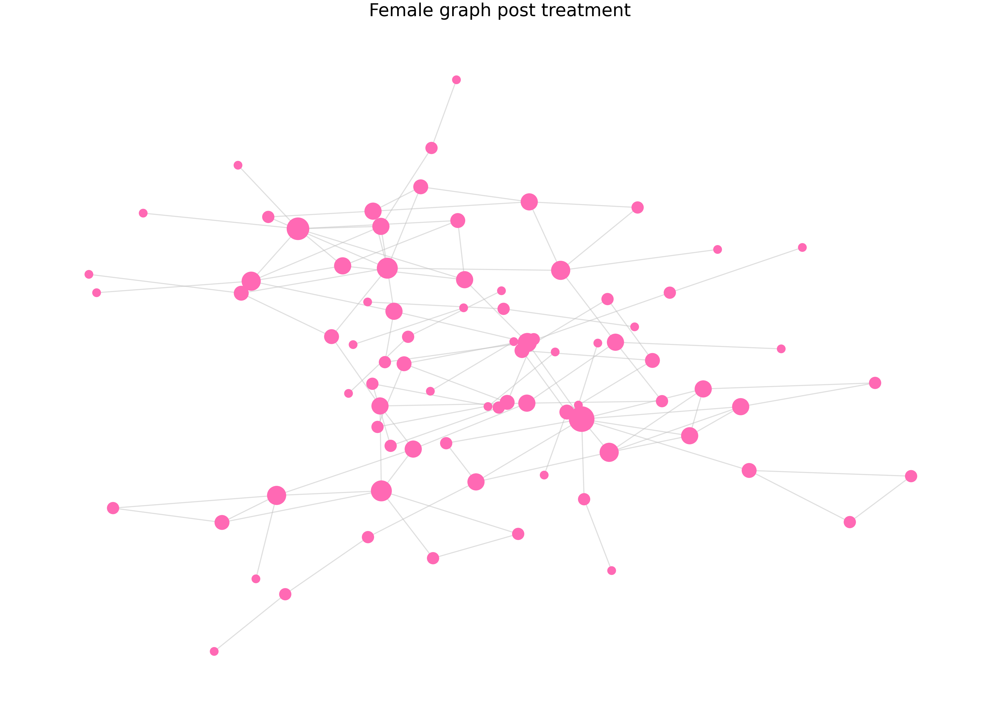

In [41]:
# Choose layout
pos = nx.kamada_kawai_layout(F_POST)

# Get the degree list 
degrees = [d for n,d in F_POST.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(F_POST, pos, node_size=[v for v in degrees], node_color='hotpink')

# Draw the edges
nx.draw_networkx_edges(F_POST, pos, edge_color='silver', width=3.0, alpha=0.5)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Female graph post treatment', fontsize=50)
plt.show()
#plt.savefig('figures/female_graph_post.svg',format='svg')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>3.3.2.1. Female averages POST.</b></p>

In [42]:
# Average nodes' degree 
avg_degree_F_POST = sum([degree for node, degree in F_POST.degree()])/F_POST.number_of_nodes()
print('Average degree Female POST: ' + str(avg_degree_F_POST))

# Average local clustering coefficient
avg_clust_F_POST = nx.average_clustering(F_POST)
print('Average clustering coefficient Female POST:', avg_clust_F_POST)

# Global clustering coefficient (transitivity)
transv_F_POST = nx.transitivity(F_POST)
print('Transitivity Female POST:', transv_F_POST)

Average degree Female POST: 1.9454545454545455
Average clustering coefficient Female POST: 0.27999278499278496
Transitivity Female POST: 0.3776978417266187


In [43]:
#Average closeness centrality
closeness_F_POST = nx.closeness_centrality(F_POST)
avg_closeness_F_POST = sum(closeness_F_POST.values()) / len(closeness_F_POST)
print("Average closeness centrality Female POST:", avg_closeness_F_POST)

#Average eigenvector centrality
eigenvector_F_POST = nx.eigenvector_centrality(F_POST, max_iter=1000)
avg_eigenvector_F_POST = sum(eigenvector_F_POST.values()) / len(eigenvector_F_POST)
print("Average eigenvector centrality Female POST:", avg_eigenvector_F_POST)

#Average betweenness centrality
betweenness_F_POST = nx.betweenness_centrality(F_POST)
avg_betweenness_F_POST = sum(betweenness_F_POST.values()) / len(betweenness_F_POST)
print("Average betweenness centrality Female: POST", avg_betweenness_F_POST)

Average closeness centrality Female POST: 0.04228246316741522
Average eigenvector centrality Female POST: 0.034650578365335534
Average betweenness centrality Female: POST 0.002985512618540141


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>3.3.3. Cluster coordinator POST.</b></p>

In [44]:
# Find nodes with attribute coord=1
node_coord_POST = [n for n, attrs in POST.nodes(data=True) if attrs['coord'] == 1]
print('The cluster coordinator is node',node_coord_POST)

# Change the color of coordinator node
nx.set_node_attributes(POST, {7440: 'darkorange'}, name='color')

# Find coordinator node' gender
if POST.nodes[7440]['gender'] == 0:
    print('The cluster coordinator is male.')
else:
    print('The cluster coordinator is female.')

neighbors_7440_POST = list(POST.neighbors(7440))

# Create a subgraph with node 7440 and its neighbors
CD_POST = POST.subgraph([7440] + neighbors_7440_POST)

# Check if the graph is connected or disconnected
print("Is the graph connected?", nx.is_connected(CD_POST))

print("Neighbors of node 7440:", neighbors_7440_POST)

The cluster coordinator is node [7440]
The cluster coordinator is male.
Is the graph connected? True
Neighbors of node 7440: [7410, 7431, 7437, 7444, 7441, 7442, 73834, 36875, 73243, 36888, 85068, 43553, 36856, 36853, 7447, 61474, 12937, 36855, 75366, 36860, 36838, 36859, 9933, 111607, 66473, 36886, 9955, 73983, 60017, 7445]


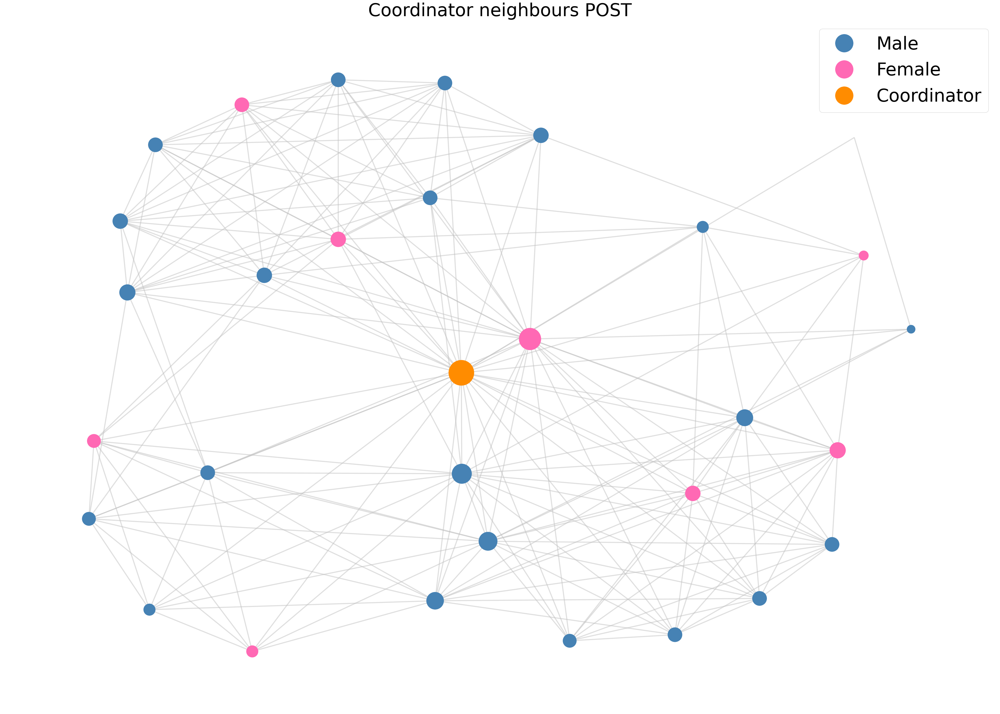

In [45]:
# Create a temporary gender value, for color mapping purposes
POST.nodes[7440]['gender'] = 2

# Choose layout
pos = nx.kamada_kawai_layout(CD_POST)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink', 2:'darkorange'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in POST.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in CD_POST.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(CD_POST, pos, node_size=[v for v in degrees],
                      node_color=[node_color_map.get(str(n)) for n in CD_POST.nodes()])

# Draw the edges
nx.draw_networkx_edges(CD_POST, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female', 'Coordinator'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Coordinator neighbours POST', fontsize=50)
plt.show()
# plt.savefig('scientists_network_connected.png')

# Restore node 7440 manhood
POST.nodes[7440]['gender'] = 0

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>3.3.3.1. Centrality measures for coordinator node POST.</b></p>

In [46]:
print(f"Degree of cluster coordinator: {POST.degree(7440)}.")
print("Clustering coefficient of cluster coordinator:", nx.clustering(POST, 7440))

Degree of cluster coordinator: 30.
Clustering coefficient of cluster coordinator: 0.3563218390804598


In [47]:
closeness_centrality_POST = nx.closeness_centrality(POST)
closeness_centrality_7440_POST = closeness_centrality_POST[7440]
print("Closeness centrality of the coordinator POST:", closeness_centrality_7440_POST)

eigenvector_centrality_POST = nx.eigenvector_centrality(POST)
eigenvector_centrality_7440_POST = eigenvector_centrality_POST[7440]
print("Eigenvector centrality of the coordinator POST:", eigenvector_centrality_7440_POST)

betweenness_centrality_POST = nx.betweenness_centrality(POST)
betweenness_centrality_7440_POST = betweenness_centrality_POST[7440]
print("Betweenness centrality of the coordinator POST:", betweenness_centrality_7440_POST)

Closeness centrality of the coordinator POST: 0.27572543526115667
Eigenvector centrality of the coordinator POST: 0.26405420616243463
Betweenness centrality of the coordinator POST: 0.018065525247492286


<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>3.3.3.2. Gender distribution into coordinator cluster POST.</b></p>

In [48]:
num_male_coord_ditrib_POST = 0
num_female_coord_ditrib_POST = 0

for node_id, node_attr in CD_POST.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_coord_ditrib_POST += 1
    elif node_attr['gender'] == 1:
        num_female_coord_ditrib_POST += 1

print("Number of male nodes POST:", num_male_coord_ditrib_POST)
print("Number of female nodes POST:", num_female_coord_ditrib_POST)

Number of male nodes POST: 22
Number of female nodes POST: 9


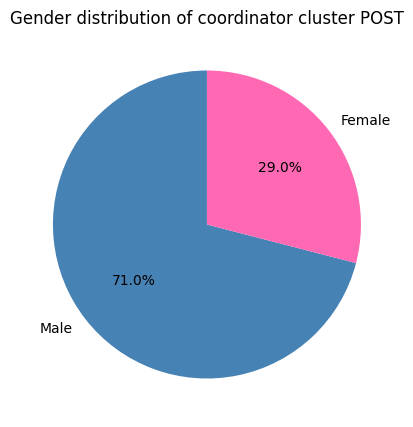

In [49]:
# Define the data
labels_coord_ditrib = ['Male', 'Female']
sizes_coord_distrib_POST = [num_male_coord_ditrib_POST, num_female_coord_ditrib_POST]
colors_coord_distrib = ['steelblue', 'hotpink']

# Create the pie chart
fig, ax = plt.subplots(figsize=(10, 5))
plt.pie(sizes_coord_distrib_POST, labels=labels_coord_ditrib, colors=colors_coord_distrib, autopct='%1.1f%%', startangle=90)

# Add a title
plt.title('Gender distribution of coordinator cluster POST')

# Display the chart
plt.show()

<p style="font-family: Times New Roman;font-size:22px;color:orangered"><b>4. Both time periods v2</b></p>

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>4.1. Male graph.</b></p>

In [50]:
# Get the nodes representing male scientists
male_nodes = [n for n, d in G.nodes(data=True) if d['gender'] == 0]

# Create a subgraph containing only these nodes
M = G.subgraph(male_nodes)

print('Graph with', M.number_of_nodes(),'nodes and', M.number_of_edges(), 'edges.')
print('Is the graph connected?',nx.is_connected(M))

Graph with 271 nodes and 1161 edges.
Is the graph connected? False


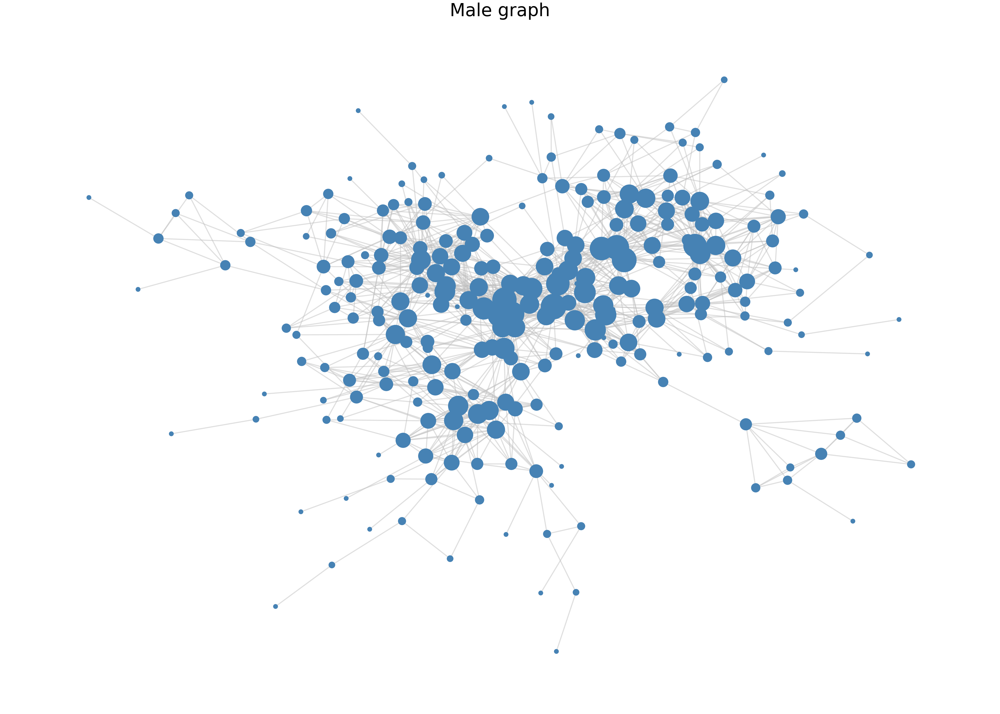

In [51]:
# Choose layout
pos = nx.kamada_kawai_layout(M)

# Get the degree list 
degrees = [d for n,d in M.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(M, pos, node_size=[v for v in degrees], node_color='steelblue')

# Draw the edges
nx.draw_networkx_edges(M, pos, edge_color='silver', width=3.0, alpha=0.5)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Male graph', fontsize=50)
plt.show()
#plt.savefig('male_graph.png')

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>4.1.1. Male graph averages.</b></p>

In [52]:
# Average nodes' degree 
avg_degree_M = sum([degree for node, degree in M.degree()])/M.number_of_nodes()
print('Average degree Male: ' + str(avg_degree_M))

# Average local clustering coefficient
avg_clust_M = nx.average_clustering(M)
print('Average clustering coefficient Male:', avg_clust_M)

# Global clustering coefficient (transitivity)
transv_M = nx.transitivity(M)
print('Transitivity Male:', transv_M)

Average degree Male: 8.568265682656827
Average clustering coefficient Male: 0.4158875006940534
Transitivity Male: 0.40683870967741936


In [53]:
#Average closeness centrality
closeness_M = nx.closeness_centrality(M)
avg_closeness_M = sum(closeness_M.values()) / len(closeness_M)
print("Average closeness centrality Male:", avg_closeness_M)

#Average eigenvector centrality
eigenvector_M = nx.eigenvector_centrality(M, max_iter=1000)
avg_eigenvector_M = sum(eigenvector_M.values()) / len(eigenvector_M)
print("Average eigenvector centrality Male:", avg_eigenvector_M)

#Average betweenness centrality
betweenness_M = nx.betweenness_centrality(M)
avg_betweenness_M = sum(betweenness_M.values()) / len(betweenness_M)
print("Average betweenness centrality Male:", avg_betweenness_M)

Average closeness centrality Male: 0.23108992702292686
Average eigenvector centrality Male: 0.03503520496398328
Average betweenness centrality Male: 0.009333054916670608


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>4.1.2. Degree distribution Male.</b></p>

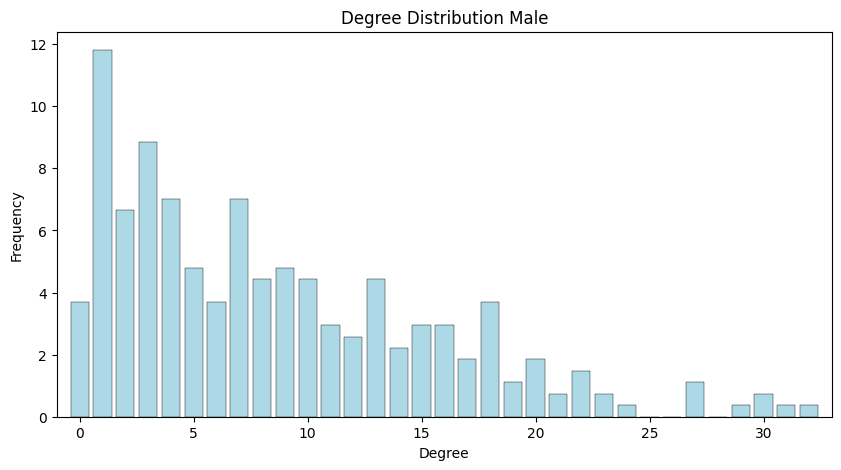

In [54]:
from matplotlib.ticker import StrMethodFormatter
from scipy import stats

#Normal scale
# Get the degree distribution using degree_histogram
degree_frequency_M= nx.degree_histogram(M)
n_M=M.number_of_nodes()
degree_frequency_M = [d_M/n_M*100 for d_M in degree_frequency_M]
degree_M=[a for a in range(0,len(degree_frequency_M))]
hist_data_M = (degree_M, degree_frequency_M)

# Plot the figure (combo bar-line)
fig, ax = plt.subplots(figsize=(10, 5))
#color='white' for visualising just one plot
ax.bar(*hist_data_M, color='lightblue', edgecolor='black', linewidth=0.3)
#ax.plot(*hist_data_M, color='red')

# Add the frequency text to each bar, using 2 decimal places
# Also test for the number of degrees
#for i, freq in enumerate(degree_frequency_M):
    #ax.text(i, freq, f'{freq:.2f}', ha='center', va='bottom')

ax.set_xlabel('Degree')
ax.set_ylabel('Frequency')
ax.set_title('Degree Distribution Male')

plt.xlim(-1, 33) #<32 degrees>
plt.show()
#plt.savefig('figures/degree_distribution_norm.svg', format='svg')

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>4.2. Female graph.</b></p>

In [55]:
# Get the nodes representing female scientists
female_nodes = [n for n, d in G.nodes(data=True) if d['gender'] == 1]

# Create a subgraph containing only these nodes
F = G.subgraph(female_nodes)

print('Graph with', F.number_of_nodes(),'nodes and', F.number_of_edges(), 'edges.')
print('Is the graph connected?',nx.is_connected(F))

Graph with 110 nodes and 145 edges.
Is the graph connected? False


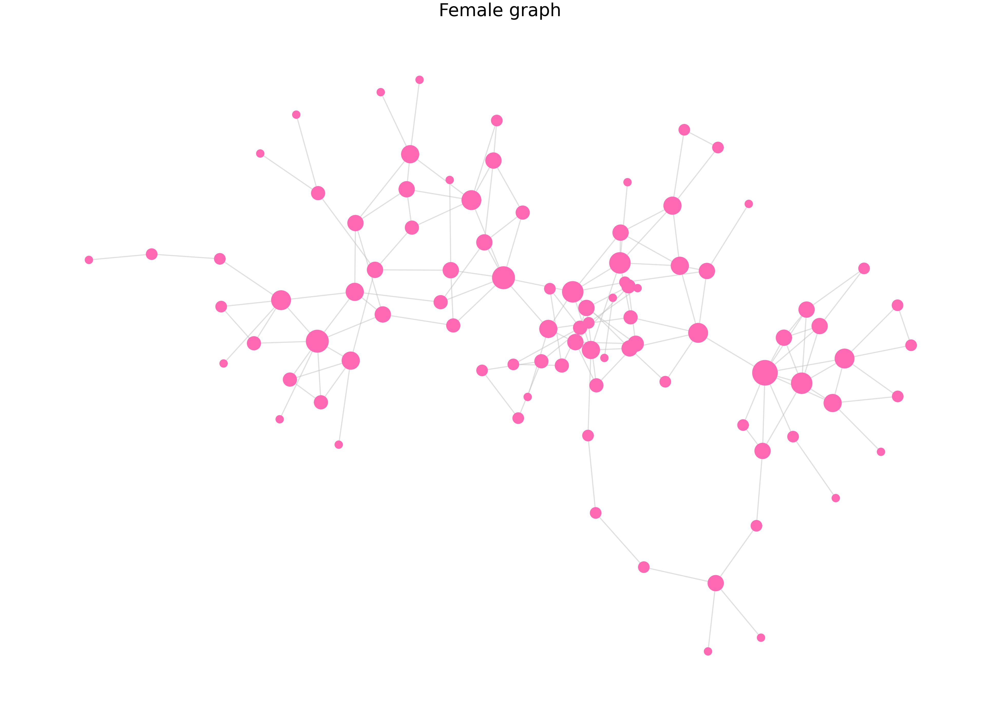

In [56]:
# Choose layout
pos = nx.kamada_kawai_layout(F)

# Get the degree list 
degrees = [d for n,d in F.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(F, pos, node_size=[v for v in degrees], node_color='hotpink')

# Draw the edges
nx.draw_networkx_edges(F, pos, edge_color='silver', width=3.0, alpha=0.5)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Female graph', fontsize=50)
plt.show()
#plt.savefig('female_graph.png')

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>4.2.1. Female graph averages.</b></p>

In [57]:
# Average nodes' degree 
avg_degree_F = sum([degree for node, degree in F.degree()])/F.number_of_nodes()
print('Average degree Female: ' + str(avg_degree_F))

# Average local clustering coefficient
avg_clust_F = nx.average_clustering(F)
print('Average clustering coefficient Female:', avg_clust_F)

# Global clustering coefficient (transitivity)
transv_F = nx.transitivity(F)
print('Transitivity Female:', transv_F)

Average degree Female: 2.6363636363636362
Average clustering coefficient Female: 0.3077344877344876
Transitivity Female: 0.33962264150943394


In [58]:
#Average closeness centrality
closeness_F = nx.closeness_centrality(F)
avg_closeness_F = sum(closeness_F.values()) / len(closeness_F)
print("Average closeness centrality Female:", avg_closeness_F)

#Average eigenvector centrality
eigenvector_F = nx.eigenvector_centrality(F, max_iter=1000)
avg_eigenvector_F = sum(eigenvector_F.values()) / len(eigenvector_F)
print("Average eigenvector centrality Female:", avg_eigenvector_F)

#Average betweenness centrality
betweenness_F = nx.betweenness_centrality(F)
avg_betweenness_F = sum(betweenness_F.values()) / len(betweenness_F)
print("Average betweenness centrality Female:", avg_betweenness_F)

Average closeness centrality Female: 0.09736726064551121
Average eigenvector centrality Female: 0.04026186841031496
Average betweenness centrality Female: 0.01871621412905817


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>4.2.2. Degree distribution Female.</b></p>

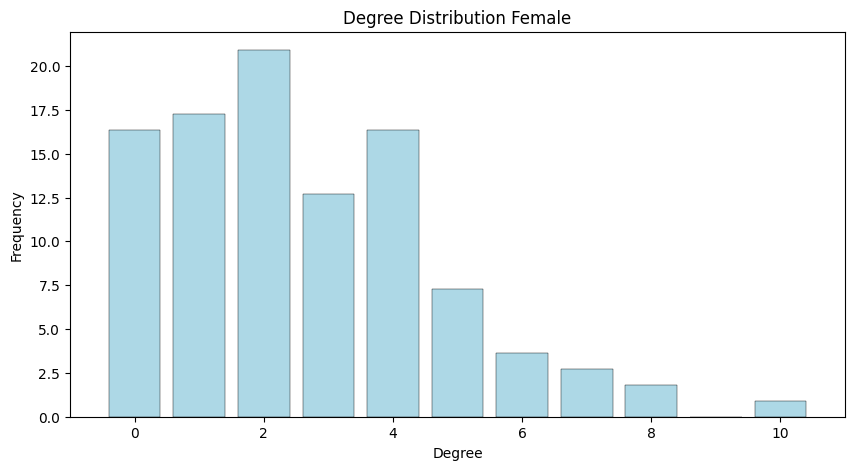

In [59]:
from matplotlib.ticker import StrMethodFormatter
from scipy import stats

#Normal scale
# Get the degree distribution using degree_histogram
degree_frequency_F= nx.degree_histogram(F)
n_F=F.number_of_nodes()
degree_frequency_F = [d_F/n_F*100 for d_F in degree_frequency_F]
degree_F=[a for a in range(0,len(degree_frequency_F))]
hist_data_F = (degree_F, degree_frequency_F)

# Plot the figure (combo bar-line)
fig, ax = plt.subplots(figsize=(10, 5))
#color='white' for visualising just one plot
ax.bar(*hist_data_F, color='lightblue', edgecolor='black', linewidth=0.3)
#ax.plot(*hist_data_F, color='red')

# Add the frequency text to each bar, using 2 decimal places
# Also test for the number of degrees
#for i, freq in enumerate(degree_frequency_F):
    #ax.text(i, freq, f'{freq:.2f}', ha='center', va='bottom')

ax.set_xlabel('Degree')
ax.set_ylabel('Frequency')
ax.set_title('Degree Distribution Female')

plt.xlim(-1, 11) #<10 degrees>
plt.show()
#plt.savefig('figures/degree_distribution_female.svg', format='svg')

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>4.3. Gender distribution.</b></p>

In [60]:
num_male = 0
num_female = 0

for node_id, node_attr in G.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male += 1
    elif node_attr['gender'] == 1:
        num_female += 1

print("Number of male nodes:", num_male)
print("Number of female nodes:", num_female)

Number of male nodes: 271
Number of female nodes: 110


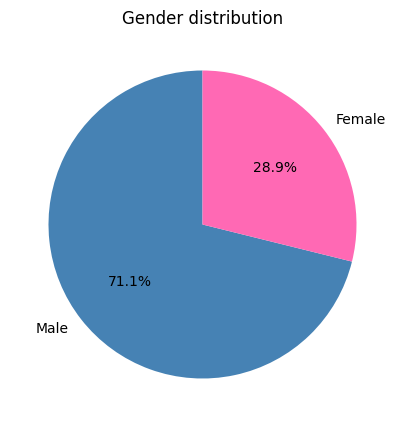

In [61]:
# Define the data
labels = ['Male', 'Female']
sizes = [num_male, num_female]
colors = ['steelblue', 'hotpink']

# Create the pie chart
fig, ax = plt.subplots(figsize=(10, 5))
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)

# Add a title
plt.title('Gender distribution')

# Display the chart
plt.show()

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>4.4. Cluster coordinator.</b></p>

In [62]:
# Find nodes with attribute coord=1
node_coord = [n for n, attrs in G.nodes(data=True) if attrs['coord'] == 1]
print('The cluster coordinator is node',node_coord)

# Change the color of coordinator node
nx.set_node_attributes(G, {7440: 'darkorange'}, name='color')

# Find coordinator node' gender
if G.nodes[7440]['gender'] == 0:
    print('The cluster coordinator is male.')
else:
    print('The cluster coordinator is female.')

print('The degree of coordinator node is:',G.degree[7440])

neighbors_7440 = list(G.neighbors(7440))

# Create a subgraph with node 7440 and its neighbors
CD = G.subgraph([7440] + neighbors_7440)

# Check if the graph is connected or disconnected
print("Is the graph connected?", nx.is_connected(CD))

The cluster coordinator is node [7440]
The cluster coordinator is male.
The degree of coordinator node is: 38
Is the graph connected? True


In [63]:
print("Neighbors of node 7440:", neighbors_7440)

Neighbors of node 7440: [2682, 7410, 7431, 7437, 7444, 7441, 7442, 73834, 36875, 73243, 36888, 85068, 43553, 54368, 36856, 36853, 7447, 61474, 12937, 36855, 75366, 36860, 36854, 36838, 36859, 9933, 111607, 66473, 36886, 9955, 73983, 36885, 82797, 60719, 60017, 8295, 7452, 7445]


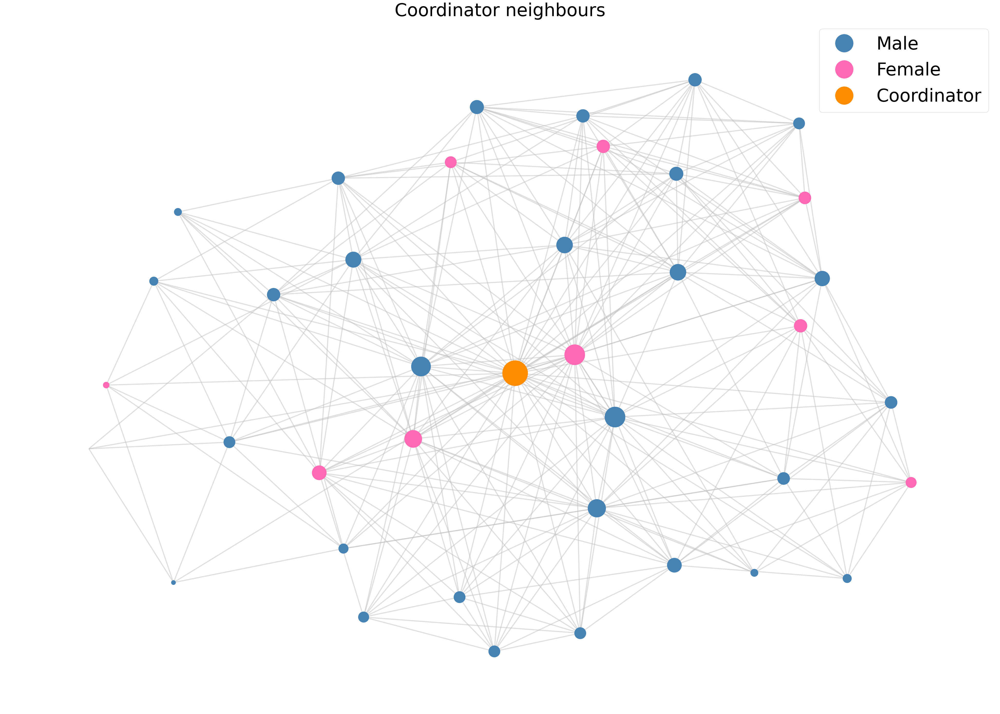

In [64]:
#Create a temporary gender value, for color mapping purposes
G.nodes[7440]['gender'] = 2

# Choose layout
pos = nx.kamada_kawai_layout(CD)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink', 2:'darkorange'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in CD.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in CD.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(CD, pos, node_size=[v for v in degrees],
                      node_color=[node_color_map.get(str(n)) for n in CD.nodes()])

# Draw the edges
nx.draw_networkx_edges(CD, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female', 'Coordinator'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Coordinator neighbours', fontsize=50)
plt.show()
#plt.savefig('scientists_network_connected.png')

# Restore node 7440 manhood
G.nodes[7440]['gender'] = 0

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>4.4.1. Centrality measures for coordinator node.</b></p>

In [65]:
closeness_centrality = nx.closeness_centrality(G)
closeness_centrality_7440 = closeness_centrality[7440]
print("Closeness centrality of the coordinator:", closeness_centrality_7440)

eigenvector_centrality = nx.eigenvector_centrality(G)
eigenvector_centrality_7440 = eigenvector_centrality[7440]
print("Eigenvector centrality of the coordinator:", eigenvector_centrality_7440)

betweenness_centrality = nx.betweenness_centrality(G)
betweenness_centrality_7440 = betweenness_centrality[7440]
print("Betweenness centrality of the coordinator:", betweenness_centrality_7440)

Closeness centrality of the coordinator: 0.3547707139134966
Eigenvector centrality of the coordinator: 0.20201101850476139
Betweenness centrality of the coordinator: 0.02046715545147526


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>4.4.2. Gender distribution into coordinator cluster.</b></p>

In [66]:
num_male_coord_ditrib = 0
num_female_coord_ditrib = 0

for node_id, node_attr in CD.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_coord_ditrib += 1
    elif node_attr['gender'] == 1:
        num_female_coord_ditrib += 1

print("Number of male nodes:", num_male_coord_ditrib)
print("Number of female nodes:", num_female_coord_ditrib)

Number of male nodes: 30
Number of female nodes: 9


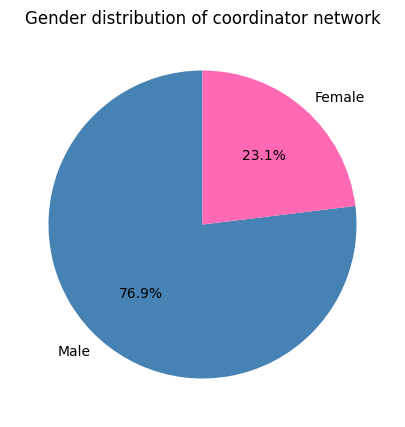

In [67]:
# Define the data
labels_coord_ditrib = ['Male', 'Female']
sizes_coord_distrib = [num_male_coord_ditrib, num_female_coord_ditrib]
colors_coord_distrib = ['steelblue', 'hotpink']

# Create the pie chart
fig, ax = plt.subplots(figsize=(10, 5))
plt.pie(sizes_coord_distrib, labels=labels_coord_ditrib, colors=colors_coord_distrib, autopct='%1.1f%%', startangle=90)

# Add a title
plt.title('Gender distribution of coordinator network')

# Display the chart
plt.show()

<p style="font-family: Times New Roman;font-size:22px;color:orangered"><b>5. Community detection.</b></p>

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>5.1. Louvain community detection algorithm.</b></p>

In [68]:
from networkx.algorithms import community 

# Community detection algorithm: Louvain  
partition = community.louvain_communities(J, weight="Weight", resolution=0.7, seed=123)
num_communities = len(partition)
print("The number of detected communities: " + str(num_communities))

modularity = community.modularity(J, partition)
print("Modularity Louvain:", modularity)

The number of detected communities: 6
Modularity Louvain: 0.611050859815107


In [69]:
# Create a dictionary to store the nodes of each community
communities = {}

# Iterate over each community
for n in range(num_communities):
    # Get the nodes of the current community
    nodes = [node for node in J.nodes if node in partition[n]]
    # Add the nodes to the communities dictionary
    communities[n+1] = nodes

# Print the communities and their nodes
for community, nodes in communities.items():
    print(f"Community {community}: {nodes}")

Community 1: [12924, 12925, 2688, 12932, 69531, 12938, 54389, 54365, 69278, 62161, 2705, 12933, 12930, 54393, 22692, 63112, 2703, 2698, 2687, 12923, 12943, 83349, 80349, 73991, 2697, 58364, 22695, 108863, 2695, 2693, 116508, 22693, 70492, 82263, 78976, 12934, 60797, 2684, 54381, 85782, 92805, 12935, 7462, 54384, 2686, 8924, 54388, 12951, 7467, 12931, 85423, 12922, 2691, 79804, 40078, 8910, 40074, 8914, 2690, 40073, 2694, 59662, 43126, 71126, 40086, 43123, 40062, 71889, 111483, 12929, 8912, 40068, 8923, 8908, 8922, 20522, 79664, 8917, 40083, 58429, 40079, 40070, 9777, 68096, 8913, 70411, 40063, 12921, 12946, 54386, 54390, 54364, 12926, 54378, 12928, 54382, 54380, 12941, 40081, 81356, 84786, 55441, 61131, 40082, 40067, 40084, 40060, 54387, 54367, 78542, 67061]
Community 2: [12948, 8295, 7440, 54391, 12936, 12937, 54376, 60719, 12939, 54392, 57200, 2682, 7410, 36837, 80484, 36833, 36839, 36838, 36860, 36842, 36841, 36853, 36830, 73243, 36836, 36859, 36888, 36876, 66473, 7409, 7447, 36875,

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.1.1. Asign a random color to each Louvain community.</b></p>

In [145]:
# Mostly useful for a large number of communities
# Get the number of communities
num_communities = len(communities)

# Assign random matplotlib CSS4 colors to each community
# https://matplotlib.org/stable/gallery/color/named_colors.html
colors = list(mcolors.CSS4_COLORS.keys())

# Create a dictionary to store the colors of each community
community_colors = {}

# Assign a random color to each community
for n in range(num_communities):
    # Generate a random integer between 0 and the length of CSS4_COLORS
    i = random.randint(0, len(colors) - 1)
    # Use the integer as an index to select a random color
    color = colors[i]
    # Add the color to the community_colors dictionary
    community_colors[n+1] = color

# Print the community colors
for community, color in community_colors.items():
    print(f"Community {community}: {color}")

Community 1: saddlebrown
Community 2: darkgreen
Community 3: magenta
Community 4: goldenrod
Community 5: lightgreen
Community 6: black


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.1.2. Visualize Louvain communities.</b></p>

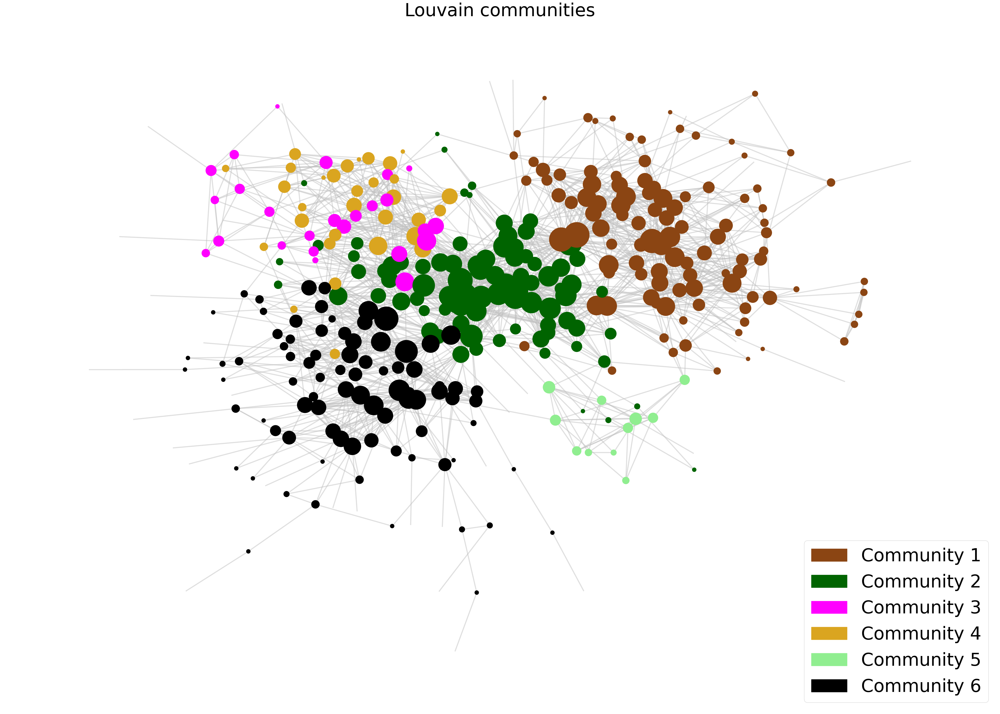

In [146]:
pos = nx.kamada_kawai_layout(J)

# Create a dictionary of node colors, corresponding to their community
node_colors = {}
for node in J.nodes():
    for community, nodes in communities.items():
        if node in nodes:
            color = community_colors[community]
            node_colors[node] = color

#Setting node sizes to be proportional to their degrees (not necessary, just for a better visualization)
degrees = dict(J.degree())
#normalizing 
degrees = [(v-min(degrees.values()))/(max(degrees.values())-min(degrees.values()))*5000 for n,v in degrees.items()]

# Draw the nodes with the appropriate colors
nx.draw_networkx_nodes(J, pos, node_color=list(node_colors.values()), node_size=degrees)

# Draw the edges
nx.draw_networkx_edges(J, pos, edge_color='silver', width=3.0, alpha=0.5)

# create legend handles and labels
legend_handles = []
legend_labels = []
for community in community_colors:
    color = community_colors[community]
    label = f"Community {community}"
    legend_handles.append(mpatches.Patch(color=color, label=label))
    legend_labels.append(label)


# Display the graph
plt.rcParams['figure.figsize'] = [50, 35]
plt.legend(handles=legend_handles, labels=legend_labels, markerscale=2, fontsize=50)
plt.axis('off')
plt.title('Louvain communities', fontsize=50)
plt.show()
#plt.savefig('louvain_communities.png')

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>5.2. Girvan-Newman community structure.</b></p>

In [72]:
from networkx.algorithms import community

# Calculate the Girvan-Newman community structure
comp = community.girvan_newman(J)
communities_GN = tuple(sorted(c) for c in next(comp))
print(f"Number of communities found: {len(communities_GN)}")

#Calculate modularity of Girvan-Newman
modularity_GN = community.modularity(J, communities_GN)
print(f"Modularity of Girvan-Newman: {modularity_GN}")

Number of communities found: 2
Modularity of Girvan-Newman: 0.030896497513684715


In [73]:
# create a dictionary to store the communities and their nodes
communities_dict_GN = {}

# assign each node to its corresponding community
for i, c in enumerate(communities_GN, start=1):
    for node in c:
        if i in communities_dict_GN:
            communities_dict_GN[i].append(node)
        else:
            communities_dict_GN[i] = [node]

# print the communities and their nodes
for i, nodes in communities_dict_GN.items():
   print(f"Community {i}: {nodes}")

Community 1: [2682, 2684, 2686, 2687, 2688, 2690, 2691, 2693, 2694, 2695, 2697, 2698, 2703, 2705, 7409, 7410, 7411, 7412, 7418, 7430, 7431, 7432, 7434, 7435, 7436, 7437, 7439, 7440, 7441, 7442, 7443, 7444, 7445, 7446, 7447, 7448, 7449, 7450, 7451, 7452, 7453, 7454, 7455, 7458, 7459, 7460, 7461, 7462, 7463, 7466, 7467, 7468, 7469, 7470, 7471, 7472, 7473, 7474, 7475, 7476, 8295, 8908, 8909, 8910, 8912, 8913, 8914, 8916, 8917, 8922, 8923, 8924, 9777, 9922, 9923, 9924, 9925, 9927, 9928, 9929, 9930, 9932, 9933, 9934, 9935, 9936, 9938, 9939, 9940, 9942, 9944, 9945, 9947, 9948, 9950, 9951, 9952, 9953, 9955, 9956, 9957, 10578, 12921, 12922, 12923, 12924, 12925, 12926, 12928, 12929, 12930, 12931, 12932, 12933, 12934, 12935, 12936, 12937, 12938, 12939, 12940, 12941, 12943, 12944, 12945, 12946, 12947, 12948, 12951, 20522, 22692, 22693, 22695, 36830, 36831, 36833, 36834, 36836, 36837, 36838, 36839, 36840, 36841, 36842, 36851, 36853, 36854, 36855, 36856, 36857, 36859, 36860, 36862, 36863, 36864, 36

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.2.1. Asign a random color to each Girvan-Newman community.</b></p>

In [123]:
# Mostly useful for a large number of communities
# Get the number of communities
num_communities_GN = len(communities_GN)

# Assign random matplotlib CSS4 colors to each community
# https://matplotlib.org/stable/gallery/color/named_colors.html
colors = list(mcolors.CSS4_COLORS.keys())

# Create a dictionary to store the colors of each community
community_colors_GN = {}

# Assign a random color to each community
for n in range(num_communities_GN):
    # Generate a random integer between 0 and the length of CSS4_COLORS
    i = random.randint(0, len(colors) - 1)
    # Use the integer as an index to select a random color
    color = colors[i]
    # Add the color to the community_colors_GN dictionary
    community_colors_GN[n+1] = color

# Print the community colors
for community, color in community_colors_GN.items():
    print(f"Community {community}: {color}")

Community 1: lightcoral
Community 2: olivedrab


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.2.2. Visualize Girvan-Newman communities.</b></p>

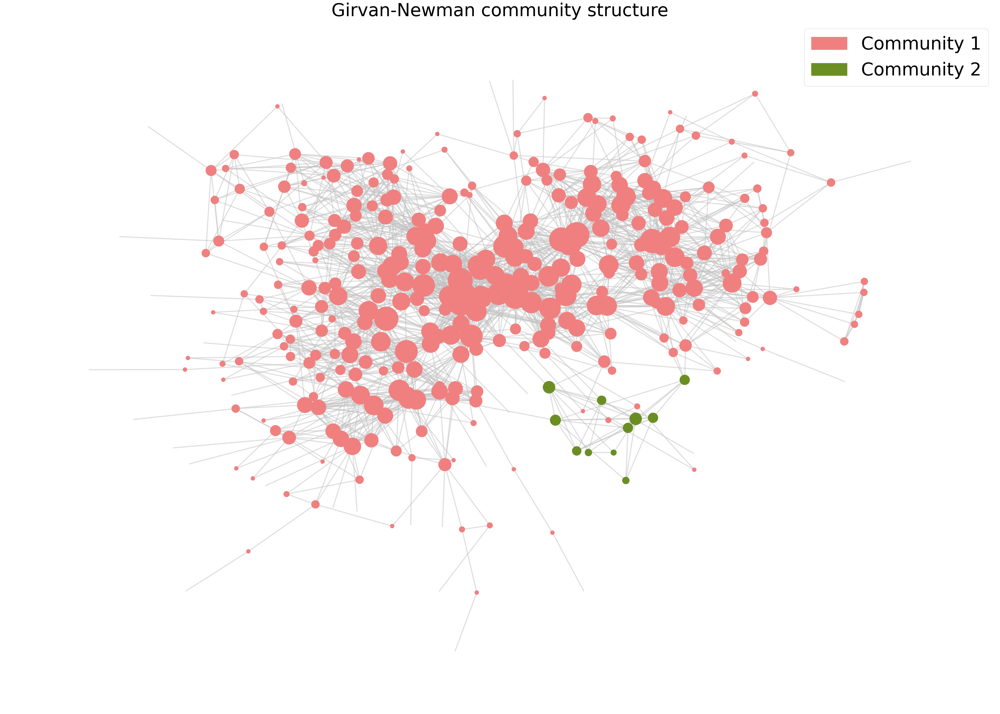

In [124]:
pos = nx.kamada_kawai_layout(J)

# Create a dictionary of node colors, corresponding to their community
node_colors = {}
for node in J.nodes():
    for community, nodes in communities_dict_GN.items():
        if node in nodes:
            color = community_colors_GN[community]
            node_colors[node] = color

#Setting node sizes to be proportional to their degrees (not necessary, just for a better visualization)
degrees = dict(J.degree())
#normalizing 
degrees = [(v-min(degrees.values()))/(max(degrees.values())-min(degrees.values()))*5000 for n,v in degrees.items()]

# Draw the nodes with the appropriate colors
nx.draw_networkx_nodes(J, pos, node_color=list(node_colors.values()), node_size=degrees)

# Draw the edges
nx.draw_networkx_edges(J, pos, edge_color='silver', width=3.0, alpha=0.5)

# create legend handles and labels
legend_handles = []
legend_labels = []
for community in community_colors_GN:
    color = community_colors_GN[community]
    label = f"Community {community}"
    legend_handles.append(mpatches.Patch(color=color, label=label))
    legend_labels.append(label)


# Display the graph
plt.rcParams['figure.figsize'] = [50, 35]
plt.legend(handles=legend_handles, labels=legend_labels, markerscale=2, fontsize=50)
plt.axis('off')
plt.title('Girvan-Newman community structure', fontsize=50)
plt.show()
#plt.savefig('girvan_newman.png')

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>5.3. Coordinator community.</b></p>

In [76]:
# Find coordinator node' community
for community, nodes in communities.items():
    if 7440 in nodes:
        print(f"The cluster coordinator is in Community {community}")

#From which communities are coordinator's neighbours?
for community, nodes in communities.items():
    intersection = set(nodes) & set(neighbors_7440)
    if intersection:
        print(f"Nodes {intersection} are in Community {community}")

The cluster coordinator is in Community 2
Nodes {7431, 12937, 36875, 7437, 7441, 7442, 7444, 7445, 36886, 7447, 36888, 73243, 43553, 61474, 66473, 60719, 85068, 9933, 36855, 54368, 9955, 75366, 36838, 8295, 73834, 82797, 60017, 7410, 36853, 36854, 111607, 2682, 36859, 36860, 73983} are in Community 2
Nodes {7452} are in Community 3
Nodes {36856, 36885} are in Community 4


In [77]:
# Find coordinator node' community
for community, nodes in communities.items():
    if 7440 in nodes:
        print(f"The cluster coordinator is in Community {community}")

#From which communities are coordinator's neighbours?
for community, nodes in communities.items():
    intersection = set(nodes) & set(neighbors_7440)
    if intersection:
        print(f"Coordinator neighbour(s) ({len(intersection)}): {intersection} are in Community {community}.")

The cluster coordinator is in Community 2
Coordinator neighbour(s) (35): {7431, 12937, 36875, 7437, 7441, 7442, 7444, 7445, 36886, 7447, 36888, 73243, 43553, 61474, 66473, 60719, 85068, 9933, 36855, 54368, 9955, 75366, 36838, 8295, 73834, 82797, 60017, 7410, 36853, 36854, 111607, 2682, 36859, 36860, 73983} are in Community 2.
Coordinator neighbour(s) (1): {7452} are in Community 3.
Coordinator neighbour(s) (2): {36856, 36885} are in Community 4.


<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>5.4. Visualizing each Louvain community.</b></p>

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.4.1. Community 1.</b></p>

In [78]:
community1_nodes = communities[1]
J1 = J.subgraph(community1_nodes)

num_male_comm1 = 0
num_female_comm1 = 0

for node_id, node_attr in J1.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_comm1 += 1
    elif node_attr['gender'] == 1:
        num_female_comm1 += 1

perc_male_comm1 = num_male_comm1/(num_male_comm1 + num_female_comm1)*100
perc_female_comm1 = num_female_comm1/(num_male_comm1 + num_female_comm1)*100

print('Graph of community 1 with', J1.number_of_nodes(),'nodes and', J1.number_of_edges(), 'edges.')
print('Gender distribution:', num_male_comm1,'males ({:.2f}%)'.format(perc_male_comm1), 'and', num_female_comm1,'females ({:.2f}%)'.format(perc_female_comm1))
print('Community 1 density:', nx.density(J1))

Graph of community 1 with 111 nodes and 552 edges.
Gender distribution: 72 males (64.86%) and 39 females (35.14%)
Community 1 density: 0.09041769041769042


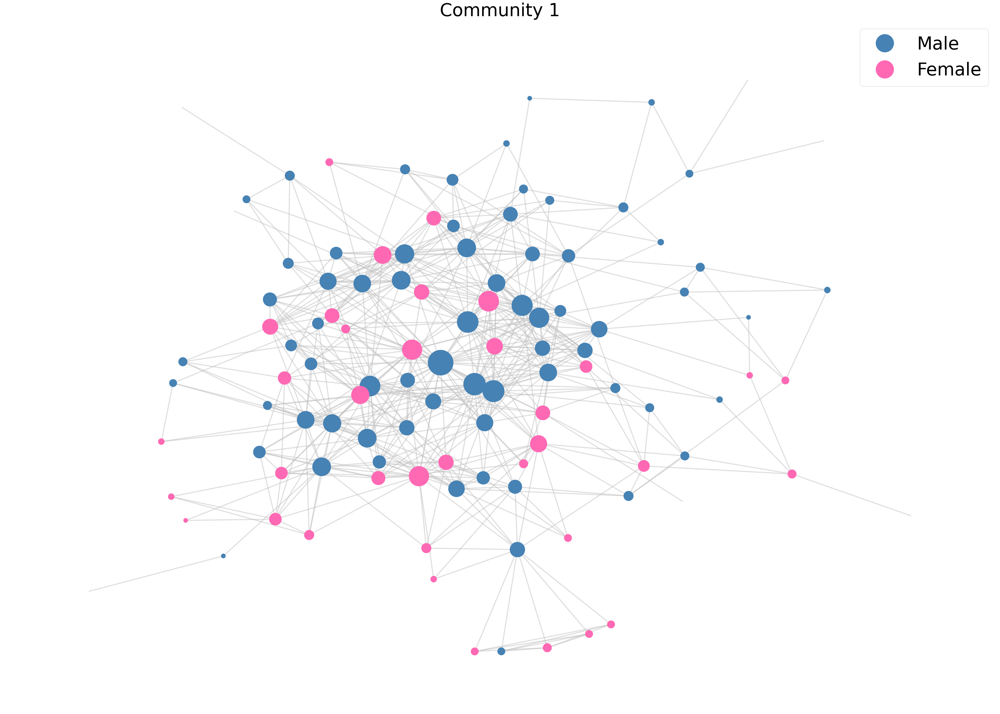

In [79]:
# Choose layout
pos = nx.kamada_kawai_layout(J1)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J1.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J1.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J1, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in J1.nodes()])

# Draw the edges
nx.draw_networkx_edges(J1, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Community 1', fontsize=50)
plt.show()
#plt.savefig('community_1.png')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>5.4.1.1. Community 1 averages.</b></p>

In [80]:
# Average nodes' degree 
avg_degree_J1 = sum([degree for node, degree in J1.degree()])/J1.number_of_nodes()
print('Average degree of Community 1: ' + str(avg_degree_J1))

# Average local clustering coefficient
avg_clust_J1 = nx.average_clustering(J1)
print('Average clustering coefficient of Community 1:', avg_clust_J1)
  
# Global clustering coefficient (transitivity)
transv_J1 = nx.transitivity(J1)
print('Transitivity of Community 1:', transv_J1)

# Average shortest path length
avg_shortest_path_J1 = nx.average_shortest_path_length(J1)
print('Average shortest path of Community 1: ', avg_shortest_path_J1)

Average degree of Community 1: 9.945945945945946
Average clustering coefficient of Community 1: 0.4802122989561855
Transitivity of Community 1: 0.4242306194000779
Average shortest path of Community 1:  2.7875511875511876


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.4.2. Community 2.</b></p>

In [81]:
community2_nodes = communities[2]
J2 = J.subgraph(community2_nodes)

num_male_comm2 = 0
num_female_comm2 = 0

for node_id, node_attr in J2.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_comm2 += 1
    elif node_attr['gender'] == 1:
        num_female_comm2 += 1

perc_male_comm2 = num_male_comm2/(num_male_comm2 + num_female_comm2)*100
perc_female_comm2 = num_female_comm2/(num_male_comm2 + num_female_comm2)*100

print('Graph of community 2 with', J2.number_of_nodes(),'nodes and', J2.number_of_edges(), 'edges.')
print('Gender distribution:', num_male_comm2,'males ({:.2f}%)'.format(perc_male_comm2), 'and', num_female_comm2,'females ({:.2f}%)'.format(perc_female_comm2))
print('Community 2 density:', nx.density(J2))

Graph of community 2 with 89 nodes and 624 edges.
Gender distribution: 66 males (74.16%) and 23 females (25.84%)
Community 2 density: 0.15934627170582227


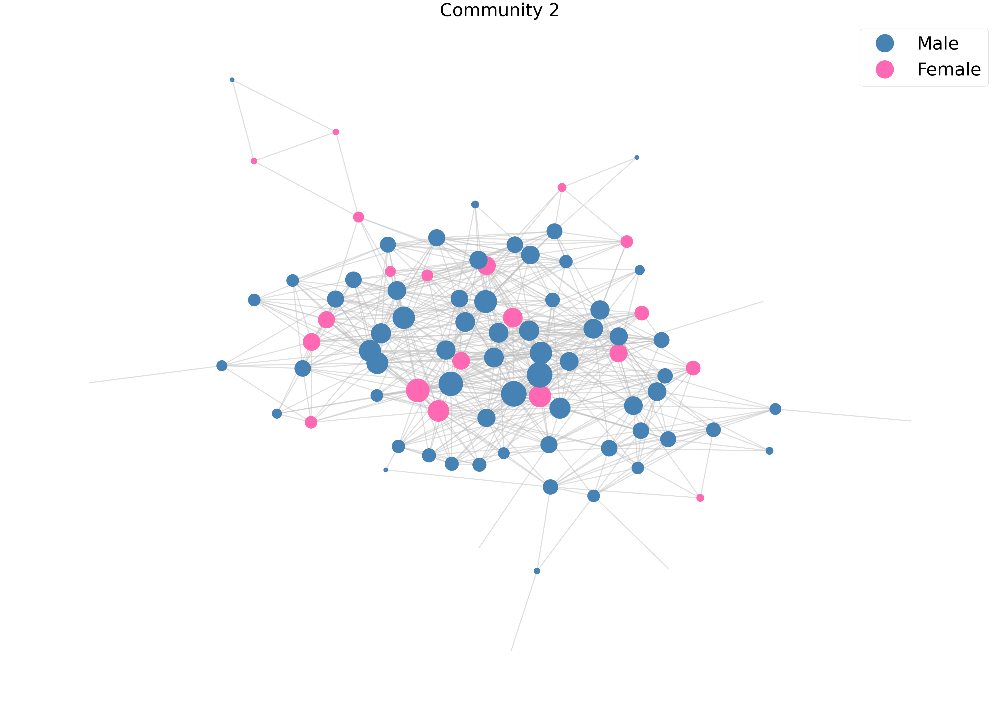

In [82]:
# Choose layout
pos = nx.kamada_kawai_layout(J2)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J2.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J2.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J2, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in J2.nodes()])

# Draw the edges
nx.draw_networkx_edges(J2, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Community 2', fontsize=50)
plt.show()
#plt.savefig('community_2.png')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>5.4.2.1. Community 2 averages.</b></p>

In [83]:
# Average nodes' degree 
avg_degree_J2 = sum([degree for node, degree in J2.degree()])/J2.number_of_nodes()
print('Average degree of Community 2: ' + str(avg_degree_J2))

# Average local clustering coefficient
avg_clust_J2 = nx.average_clustering(J2)
print('Average clustering coefficient of Community 2:', avg_clust_J2)

# Global clustering coefficient (transitivity)
transv_J2 = nx.transitivity(J2)
print('Transitivity of Community 2:', transv_J2)

# Average shortest path length
avg_shortest_path_J2 = nx.average_shortest_path_length(J2)
print("Average shortest path of Community 2: ", avg_shortest_path_J2)

Average degree of Community 2: 14.02247191011236
Average clustering coefficient of Community 2: 0.5325082837091842
Transitivity of Community 2: 0.4686080683943361
Average shortest path of Community 2:  2.3820224719101124


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.4.3. Community 3.</b></p>

In [84]:
community3_nodes = communities[3]
J3 = J.subgraph(community3_nodes)

num_male_comm3 = 0
num_female_comm3 = 0

for node_id, node_attr in J3.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_comm3 += 1
    elif node_attr['gender'] == 1:
        num_female_comm3 += 1

perc_male_comm3 = num_male_comm3/(num_male_comm3 + num_female_comm3)*100
perc_female_comm3 = num_female_comm3/(num_male_comm3 + num_female_comm3)*100

print('Graph of community 3 with', J3.number_of_nodes(),'nodes and', J3.number_of_edges(), 'edges.')
print('Gender distribution:', num_male_comm3,'males ({:.2f}%)'.format(perc_male_comm3), 'and', num_female_comm3,'females ({:.2f}%)'.format(perc_female_comm3))
print('Community 3 density:', nx.density(J3))

Graph of community 3 with 27 nodes and 97 edges.
Gender distribution: 20 males (74.07%) and 7 females (25.93%)
Community 3 density: 0.27635327635327633


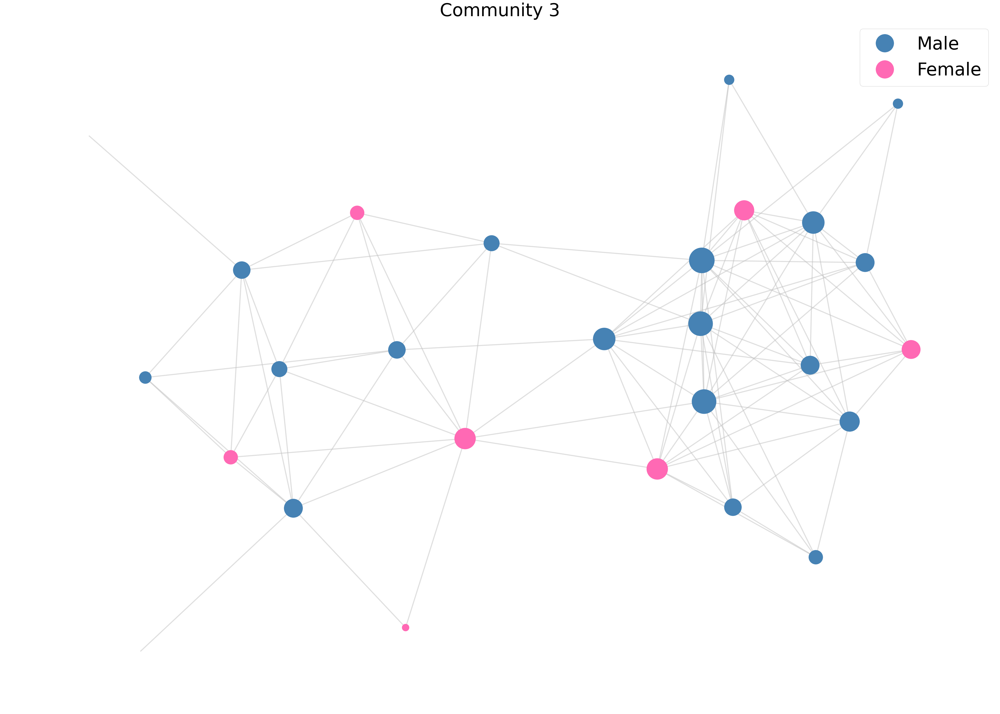

In [85]:
# Choose layout
pos = nx.kamada_kawai_layout(J3)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J3.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J3.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J3, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in J3.nodes()])

# Draw the edges
nx.draw_networkx_edges(J3, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Community 3', fontsize=50)
plt.show()
#plt.savefig('community_3.png')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>5.4.3.1. Community 3 averages.</b></p>

In [86]:
# Average nodes' degree 
avg_degree_J3 = sum([degree for node, degree in J3.degree()])/J3.number_of_nodes()
print('Average degree of Community 3: ' + str(avg_degree_J3))

# Average local clustering coefficient
avg_clust_J3 = nx.average_clustering(J3)
print('Average clustering coefficient of Community 3:', avg_clust_J3)

# Global clustering coefficient (transitivity)
transv_J3 = nx.transitivity(J3)
print('Transitivity of Community 3:', transv_J3)

# Average shortest path length
avg_shortest_path_J3 = nx.average_shortest_path_length(J3)
print('Average shortest path of Community 3:', avg_shortest_path_J3)

Average degree of Community 3: 7.185185185185185
Average clustering coefficient of Community 3: 0.6213272324383436
Transitivity of Community 3: 0.5984354628422425
Average shortest path of Community 3: 2.2051282051282053


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.4.4. Community 4.</b></p>

In [87]:
community4_nodes = communities[4]
J4 = J.subgraph(community4_nodes)

num_male_comm4 = 0
num_female_comm4 = 0

for node_id, node_attr in J4.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_comm4 += 1
    elif node_attr['gender'] == 1:
        num_female_comm4 += 1

perc_male_comm4 = num_male_comm4/(num_male_comm4 + num_female_comm4)*100
perc_female_comm4 = num_female_comm4/(num_male_comm4 + num_female_comm4)*100

print('Graph of community 4 with', J4.number_of_nodes(),'nodes and', J4.number_of_edges(), 'edges.')
print('Gender distribution:', num_male_comm4,'males ({:.2f}%)'.format(perc_male_comm4), 'and', num_female_comm4,'females ({:.2f}%)'.format(perc_female_comm4))
print('Community 4 density:', nx.density(J4))

Graph of community 4 with 31 nodes and 126 edges.
Gender distribution: 25 males (80.65%) and 6 females (19.35%)
Community 4 density: 0.2709677419354839


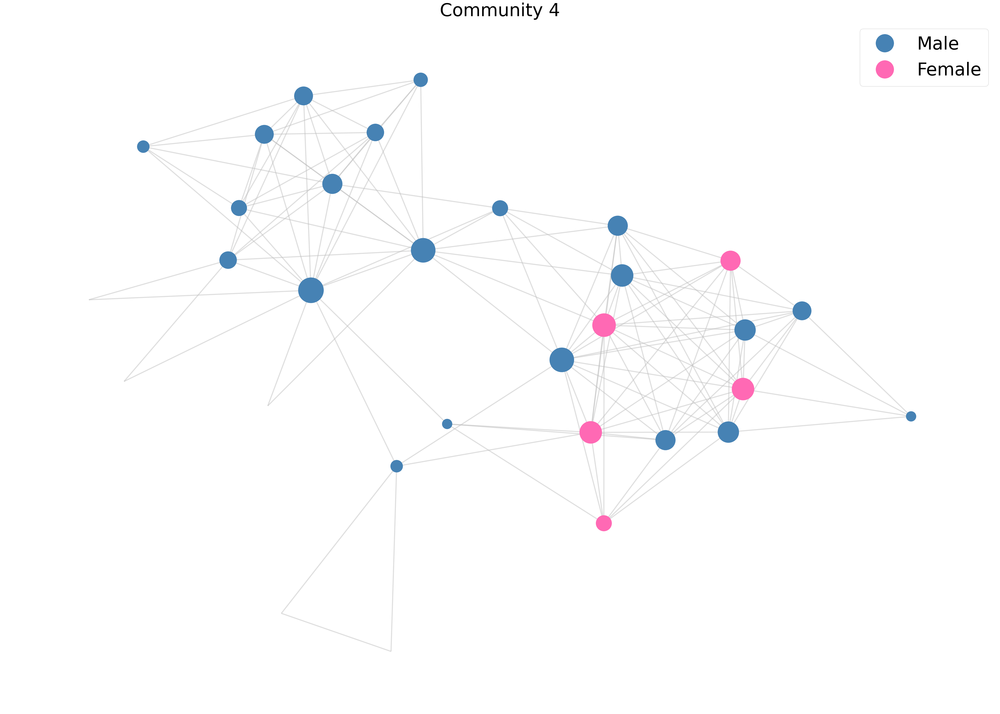

In [88]:
# Choose layout
pos = nx.kamada_kawai_layout(J4)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J4.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J4.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J4, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in J4.nodes()])

# Draw the edges
nx.draw_networkx_edges(J4, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Community 4', fontsize=50)
plt.show()
#plt.savefig('community_4.png')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>5.4.4.1. Community 4 averages.</b></p>

In [89]:
# Average nodes' degree 
avg_degree_J4 = sum([degree for node, degree in J4.degree()])/J4.number_of_nodes()
print('Average degree of Community 4: ' + str(avg_degree_J4))

# Average local clustering coefficient
avg_clust_J4 = nx.average_clustering(J4)
print('Average clustering coefficient of Community 4:', avg_clust_J4)

# Global clustering coefficient (transitivity)
transv_J4 = nx.transitivity(J4)
print('Transitivity of Community 4:', transv_J4)

# Average shortest path length
avg_shortest_path_J4 = nx.average_shortest_path_length(J4)
print('Average shortest path of Community 4:', avg_shortest_path_J4)

Average degree of Community 4: 8.129032258064516
Average clustering coefficient of Community 4: 0.7647442163571196
Transitivity of Community 4: 0.6731448763250883
Average shortest path of Community 4: 2.1655913978494623


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.4.5. Community 5.</b></p>

In [90]:
community5_nodes = communities[5]
J5 = J.subgraph(community5_nodes)

num_male_comm5 = 0
num_female_comm5 = 0

for node_id, node_attr in J5.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_comm5 += 1
    elif node_attr['gender'] == 1:
        num_female_comm5 += 1

perc_male_comm5 = num_male_comm5/(num_male_comm5 + num_female_comm5)*100
perc_female_comm5 = num_female_comm5/(num_male_comm5 + num_female_comm5)*100

print('Graph of community 5 with', J5.number_of_nodes(),'nodes and', J5.number_of_edges(), 'edges.')
print('Gender distribution:', num_male_comm5,'males ({:.2f}%)'.format(perc_male_comm5), 'and', num_female_comm5,'females ({:.2f}%)'.format(perc_female_comm5))
print('Community 5 density:', nx.density(J5))

Graph of community 5 with 12 nodes and 33 edges.
Gender distribution: 9 males (75.00%) and 3 females (25.00%)
Community 5 density: 0.5


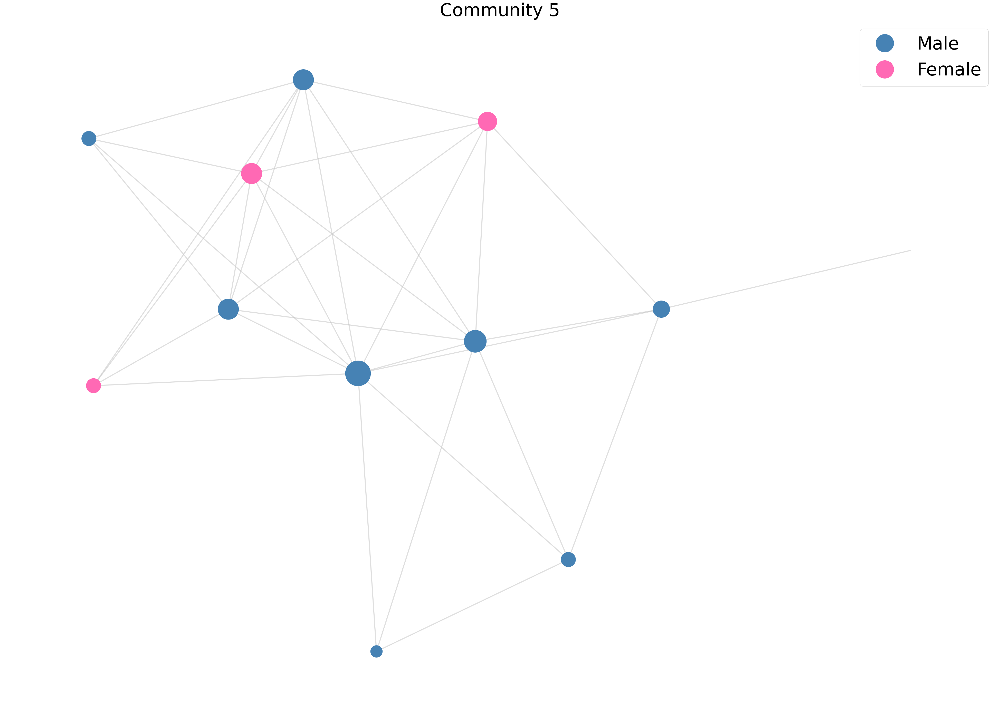

In [91]:
# Choose layout
pos = nx.kamada_kawai_layout(J5)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J5.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J5.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J5, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in J5.nodes()])

# Draw the edges
nx.draw_networkx_edges(J5, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Community 5', fontsize=50)
plt.show()
#plt.savefig('community_5.png')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>5.4.5.1. Community 5 averages.</b></p>

In [92]:
# Average nodes' degree 
avg_degree_J5 = sum([degree for node, degree in J5.degree()])/J5.number_of_nodes()
print('Average degree of Community 5: ' + str(avg_degree_J5))

# Average local clustering coefficient
avg_clust_J5 = nx.average_clustering(J5)
print('Average clustering coefficient of Community 5:', avg_clust_J5)

# Global clustering coefficient (transitivity)
transv_J5 = nx.transitivity(J5)
print('Transitivity of Community 5:', transv_J5)

# Average shortest path length
avg_shortest_path_J5 = nx.average_shortest_path_length(J5)
print('Average shortest path of Community 5:', avg_shortest_path_J5)

Average degree of Community 5: 5.5
Average clustering coefficient of Community 5: 0.7066137566137566
Transitivity of Community 5: 0.6758241758241759
Average shortest path of Community 5: 1.5909090909090908


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.4.6. Community 6.</b></p>

In [93]:
community6_nodes = communities[6]
J6 = J.subgraph(community6_nodes)

num_male_comm6 = 0
num_female_comm6 = 0

for node_id, node_attr in J6.nodes(data=True):
    if node_attr['gender'] == 0:
        num_male_comm6 += 1
    elif node_attr['gender'] == 1:
        num_female_comm6 += 1

perc_male_comm6 = num_male_comm6/(num_male_comm6 + num_female_comm6)*100
perc_female_comm6 = num_female_comm6/(num_male_comm6 + num_female_comm6)*100

print('Graph of community 6 with', J6.number_of_nodes(),'nodes and', J6.number_of_edges(), 'edges.')
print('Gender distribution:', num_male_comm6,'males ({:.2f}%)'.format(perc_male_comm6), 'and', num_female_comm6,'females ({:.2f}%)'.format(perc_female_comm6))
print('Community 6 density:', nx.density(J6))

Graph of community 6 with 100 nodes and 396 edges.
Gender distribution: 73 males (73.00%) and 27 females (27.00%)
Community 6 density: 0.08


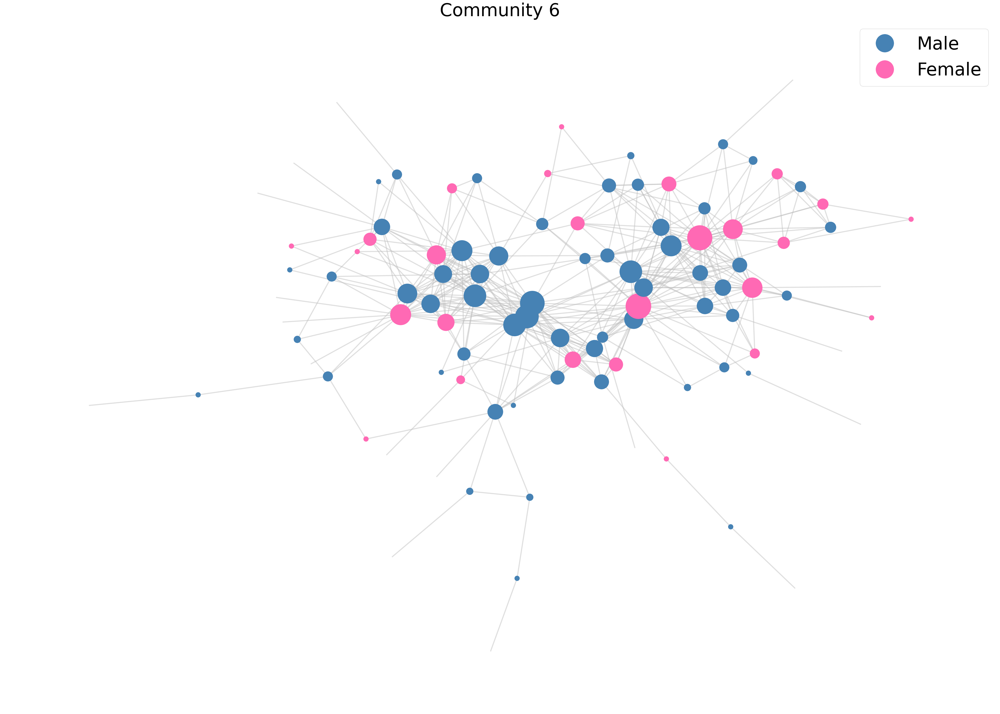

In [94]:
# Choose layout
pos = nx.kamada_kawai_layout(J6)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J6.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J6.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J6, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in J6.nodes()])

# Draw the edges
nx.draw_networkx_edges(J6, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Community 6', fontsize=50)
plt.show()
#plt.savefig('community_6.png')

<p style="font-family: Times New Roman;font-size:16px;color:navy"><b>5.4.6.1. Community 6 averages.</b></p>

In [95]:
# Average nodes' degree 
avg_degree_J6 = sum([degree for node, degree in J6.degree()])/J6.number_of_nodes()
print('Average degree of Community 6: ' + str(avg_degree_J6))

# Average local clustering coefficient
avg_clust_J6 = nx.average_clustering(J6)
print('Average clustering coefficient of Community 6:', avg_clust_J6)

# Global clustering coefficient (transitivity)
transv_J6 = nx.transitivity(J6)
print('Transitivity of Community 6:', transv_J6)

# Average shortest path length
avg_shortest_path_J6 = nx.average_shortest_path_length(J6)
print('Average shortest path of Community 6:', avg_shortest_path_J6)

Average degree of Community 6: 7.92
Average clustering coefficient of Community 6: 0.47230554203577485
Transitivity of Community 6: 0.5058275058275058
Average shortest path of Community 6: 3.163838383838384


<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>5.5. Communities' summary info.</b></p>

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.5.1.  Communities' averages data frame.</b></p>

In [96]:
# Create an iterator for the graphs and their corresponding names
graphs = [(J1, 'J1'), (J2, 'J2'), (J3, 'J3'), (J4, 'J4'), (J5, 'J5'), (J6, 'J6')]

# Create an iterator for the metric functions
metric_funcs = [lambda J: sum([degree for node, degree in J.degree()])/J.number_of_nodes(),
                nx.average_clustering,
                nx.transitivity,
                nx.average_shortest_path_length]

# Create a list of dictionaries to hold the data for each row of the table
table_data = []
for graph, name in graphs:
    row = {'Graph': name}
    for metric_func in metric_funcs:
        metric_value = metric_func(graph)
        metric_name = metric_func.__name__
        row[metric_name] = metric_value
    table_data.append(row)
    
# Create a pandas DataFrame from the list of dictionaries
communities_averages_df = pd.DataFrame(table_data)

# Rename the header
communities_averages_df = communities_averages_df.rename(columns={ 
    '<lambda>': 'Avg_Degree',
    'average_clustering': 'Avg_Clust_Coeff', 
    'transitivity': 'Transitivity', 
    'average_shortest_path_length': 'Avg_Shortest_Path'
})

# Print the table
print(communities_averages_df)

# Save the table as a excel file, for further analysis
#communities_averages_df.to_excel('communities_averages.xlsx', index=False)

  Graph  Avg_Degree  Avg_Clust_Coeff  Transitivity  Avg_Shortest_Path
0    J1    9.945946         0.480212      0.424231           2.787551
1    J2   14.022472         0.532508      0.468608           2.382022
2    J3    7.185185         0.621327      0.598435           2.205128
3    J4    8.129032         0.764744      0.673145           2.165591
4    J5    5.500000         0.706614      0.675824           1.590909
5    J6    7.920000         0.472306      0.505828           3.163838


In [97]:
# melt the dataframe to get the graphs as columns and metrics as rows
melted_df = pd.melt(communities_averages_df, id_vars=['Graph'], var_name='Metric', value_name='Value')
transposed_df = melted_df.pivot(index='Metric', columns='Graph', values='Value')

print(transposed_df)

# Save the table as a CSV file
#transposed_df.to_csv('transposed_df.csv', index=False)

Graph                    J1         J2        J3        J4        J5        J6
Metric                                                                        
Avg_Clust_Coeff    0.480212   0.532508  0.621327  0.764744  0.706614  0.472306
Avg_Degree         9.945946  14.022472  7.185185  8.129032  5.500000  7.920000
Avg_Shortest_Path  2.787551   2.382022  2.205128  2.165591  1.590909  3.163838
Transitivity       0.424231   0.468608  0.598435  0.673145  0.675824  0.505828


<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.5.2. Plot communities' metrics.</b></p>

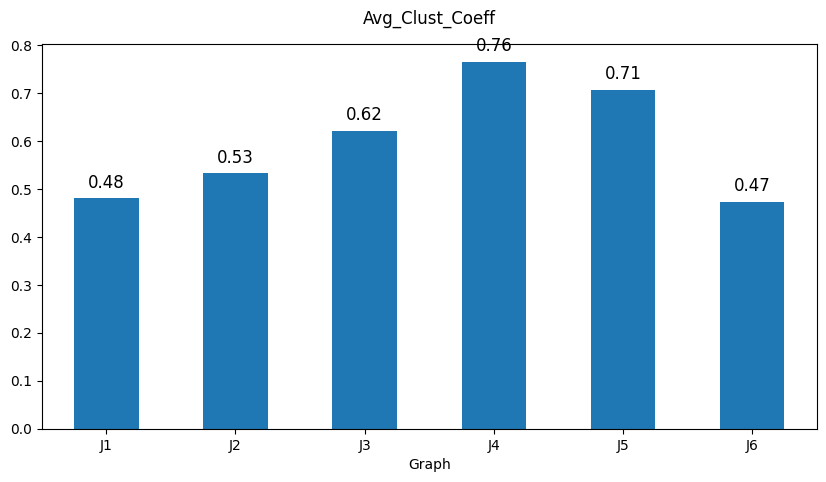

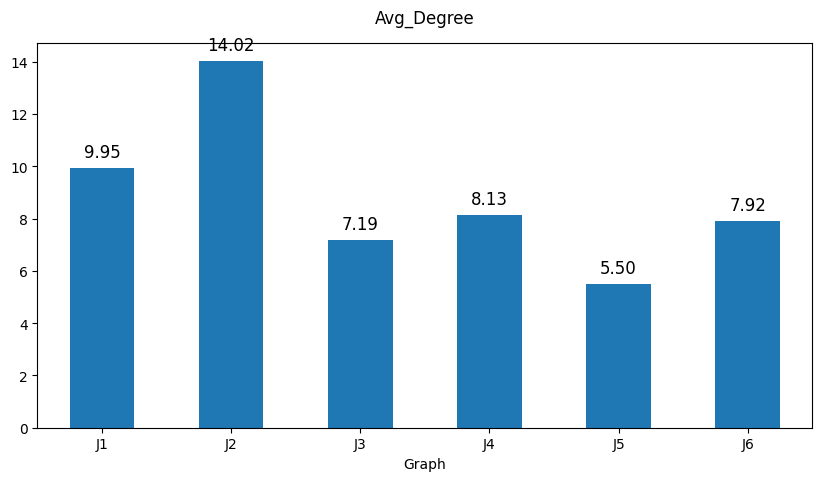

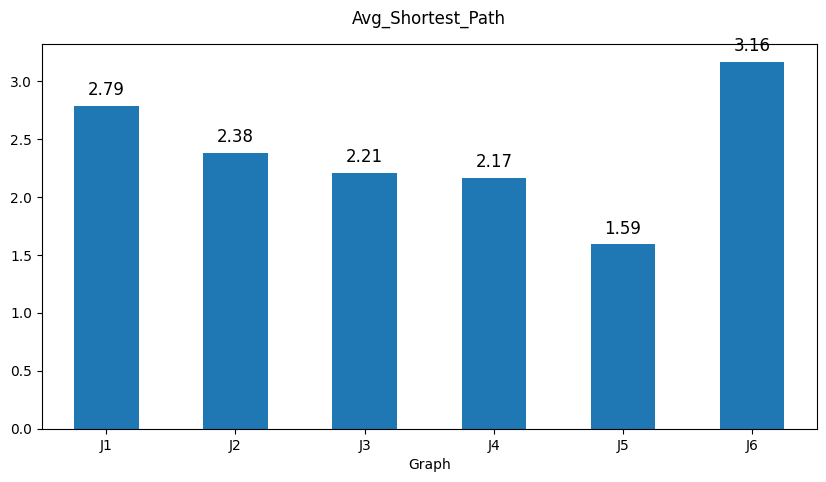

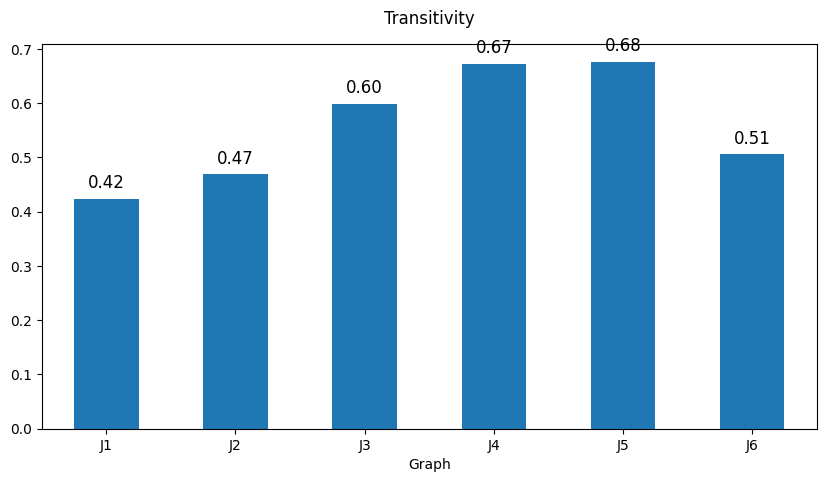

In [98]:
# create a bar graph for each Metric
for metric in transposed_df.index:
    plt.figure(figsize=(10, 5))
    plt.title(metric, y=1.03)
    ax = transposed_df.loc[metric, ['J1', 'J2', 'J3', 'J4', 'J5', 'J6']].plot(kind='bar', rot=0)
    #plt.savefig(metric + '_plot.svg',format='svg') # save plot with metric name
    for p in ax.patches:
        ax.annotate("{:.2f}".format(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha='center', va='bottom', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')
    plt.show()

# Better view in .html file

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.5.3. Minimum and maximum communities' averages.</b></p>

In [99]:
# Calculate the minimum and maximum values of each metric
min_degrees = communities_averages_df['Avg_Degree'].min()
min_degrees_graph = communities_averages_df.loc[communities_averages_df['Avg_Degree'].idxmin(), 'Graph']
max_degrees = communities_averages_df['Avg_Degree'].max()
max_degrees_graph = communities_averages_df.loc[communities_averages_df['Avg_Degree'].idxmax(), 'Graph']

min_clustering = communities_averages_df['Avg_Clust_Coeff'].min()
min_clustering_graph = communities_averages_df.loc[communities_averages_df['Avg_Clust_Coeff'].idxmin(), 'Graph']
max_clustering = communities_averages_df['Avg_Clust_Coeff'].max()
max_clustering_graph = communities_averages_df.loc[communities_averages_df['Avg_Clust_Coeff'].idxmax(), 'Graph']

min_transitivity = communities_averages_df['Transitivity'].min()
min_transitivity_graph = communities_averages_df.loc[communities_averages_df['Transitivity'].idxmin(), 'Graph']
max_transitivity = communities_averages_df['Transitivity'].max()
max_transitivity_graph = communities_averages_df.loc[communities_averages_df['Transitivity'].idxmax(), 'Graph']

min_shortest_path = communities_averages_df['Avg_Shortest_Path'].min()
min_shortest_path_graph = communities_averages_df.loc[communities_averages_df['Avg_Shortest_Path'].idxmin(), 'Graph']
max_shortest_path = communities_averages_df['Avg_Shortest_Path'].max()
max_shortest_path_graph = communities_averages_df.loc[communities_averages_df['Avg_Shortest_Path'].idxmax(), 'Graph']

# Print the results
print("Minimum degree:", min_degrees, "(", min_degrees_graph, ")")
print("Maximum degree:", max_degrees, "(", max_degrees_graph, ")")
print("=" * 30)
print("Minimum local clustering coefficient:", min_clustering, "(", min_clustering_graph, ")")
print("Maximum local clustering coefficient:", max_clustering, "(", max_clustering_graph, ")")
print("=" * 30)
print("Minimum transitivity:", min_transitivity, "(", min_transitivity_graph, ")")
print("Maximum transitivity:", max_transitivity, "(", max_transitivity_graph, ")")
print("=" * 30)
print("Minimum shortest path length:", min_shortest_path, "(", min_shortest_path_graph, ")")
print("Maximum shortest path length:", max_shortest_path, "(", max_shortest_path_graph, ")")

Minimum degree: 5.5 ( J5 )
Maximum degree: 14.02247191011236 ( J2 )
Minimum local clustering coefficient: 0.47230554203577485 ( J6 )
Maximum local clustering coefficient: 0.7647442163571196 ( J4 )
Minimum transitivity: 0.4242306194000779 ( J1 )
Maximum transitivity: 0.6758241758241759 ( J5 )
Minimum shortest path length: 1.5909090909090908 ( J5 )
Maximum shortest path length: 3.163838383838384 ( J6 )


<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>5.6. Highest centrality measures on communities.</b></p>

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.6.1. Highest closeness centrality for each community.</b></p>

In [100]:
graphs = [J1, J2, J3, J4, J5, J6]
graph_names = ["J1", "J2", "J3", "J4", "J5", "J6"]
closeness_centralities = {}

for i, J in enumerate(graphs):
    closeness = nx.closeness_centrality(J)
    closeness_centralities[f"J{i+1}"] = closeness
    
max_closeness_nodes = []
for i, J in enumerate(graphs):
    closeness = nx.closeness_centrality(J)
    max_closeness = max(closeness.values())
    nodes_with_max_closeness = [node for node, centrality in closeness.items() if centrality == max_closeness]
    max_closeness_nodes.append(nodes_with_max_closeness)
    print(f"Node(s) in {graph_names[i]} with highest closeness centrality: {nodes_with_max_closeness}")

Node(s) in J1 with highest closeness centrality: [12923]
Node(s) in J2 with highest closeness centrality: [36853]
Node(s) in J3 with highest closeness centrality: [7436]
Node(s) in J4 with highest closeness centrality: [7448, 7454]
Node(s) in J5 with highest closeness centrality: [43120]
Node(s) in J6 with highest closeness centrality: [43544]


<p style="font-family: Times New Roman;font-size:18px;color:red">For an unknown reason, all nodes, beside the last one, are eliminated from J graph. Reload the graph after each iteration.</p>

In [101]:
nodes_df = pd.read_csv("nodes_cluster_G.csv", delimiter=';', header=0)
edges_df = pd.read_csv('edges_cluster_G.csv', delimiter=';', header=0)
G = nx.Graph()
for _, row in nodes_df.iterrows():
    G.add_node(row['id'], coord=row['coord'], core=row['core'], gender=row['gender'])
for _, row in edges_df.iterrows():
    G.add_edge(row['source'], row['target'], pre_link=row['pre_link'], post_link=row['post_link'])
components = list(nx.connected_components(G))
largest_component = max(components, key=len)
J = G.subgraph(largest_component).copy()

In [102]:
gender_list_closeness = []
for node_list in max_closeness_nodes:
    for node in node_list:
        gender = J.nodes[node]['gender']
        if gender == 0:
            gender_list_closeness.append("Male")
        elif gender == 1:
            gender_list_closeness.append("Female")       
print('What gender are the nodes with maximum closeness centrality in their community?',gender_list_closeness)
print (max_closeness_nodes)
list_max_closeness_nodes = [item for sublist in max_closeness_nodes for item in sublist]

What gender are the nodes with maximum closeness centrality in their community? ['Male', 'Male', 'Male', 'Male', 'Male', 'Male', 'Male']
[[12923], [36853], [7436], [7448, 7454], [43120], [43544]]


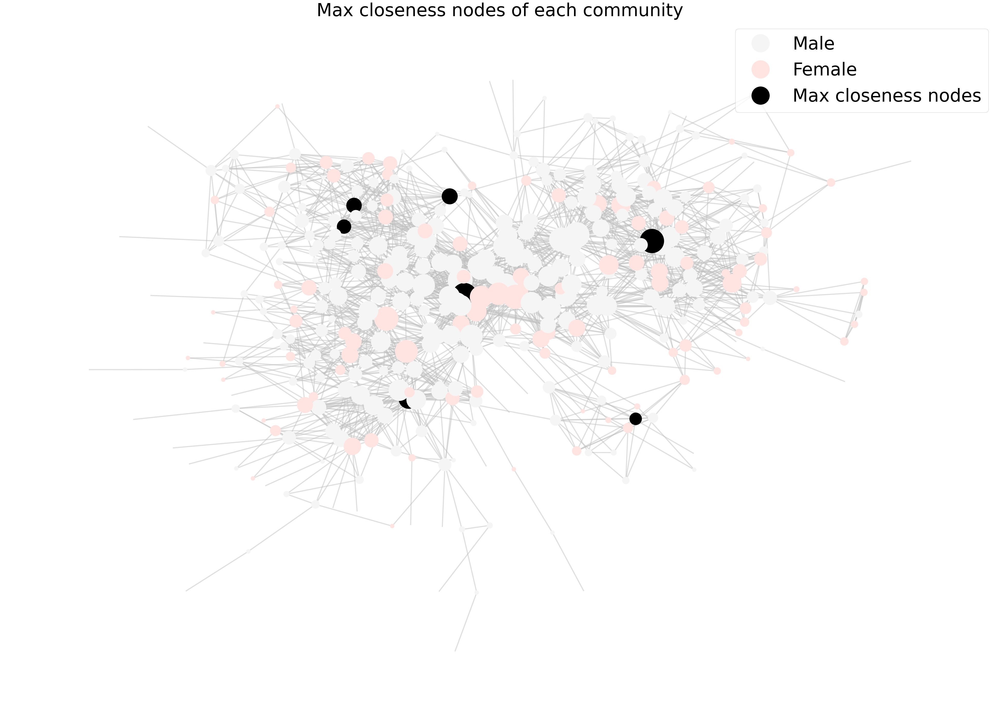

In [103]:
#Create a temporary gender value, for color mapping purposes
for node in list_max_closeness_nodes:
    J.nodes[node]['gender'] = 2

# Choose layout
pos = nx.kamada_kawai_layout(J)

# Define the colors for each gender
gender_colors = {0: 'whitesmoke', 1: 'mistyrose', 2:'black'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J, pos, node_size=[v for v in degrees],
                      node_color=[node_color_map.get(str(n)) for n in J.nodes()])

# Draw the edges
nx.draw_networkx_edges(J, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female', 'Max closeness nodes'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Max closeness nodes of each community', fontsize=50)
plt.show()
#plt.savefig('scientists_network_connected.png')

# Restore the previous genders of the nodes
for node in list_max_closeness_nodes:
    J.nodes[node]['gender'] = 0

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.6.2. Highest eigenvector centrality for each community.</b></p>

In [104]:
graphs = [J1, J2, J3, J4, J5, J6]
graph_names = ["J1", "J2", "J3", "J4", "J5", "J6"]
eigenvector_centralities = {}

for i, J in enumerate(graphs):
    eigenvector = nx.eigenvector_centrality(J)
    eigenvector_centralities[f"J{i+1}"] = eigenvector
    
max_eigenvector_nodes = []
for i, J in enumerate(graphs):
    eigenvector = nx.eigenvector_centrality(J)
    max_eigenvector = max(eigenvector.values())
    nodes_with_max_eigenvector = [node for node, centrality in eigenvector.items() if centrality == max_eigenvector]
    max_eigenvector_nodes.append(nodes_with_max_eigenvector)
    print(f"Node(s) in {graph_names[i]} with highest eigenvector centrality: {nodes_with_max_eigenvector}")

Node(s) in J1 with highest eigenvector centrality: [12923]
Node(s) in J2 with highest eigenvector centrality: [36853]
Node(s) in J3 with highest eigenvector centrality: [7452]
Node(s) in J4 with highest eigenvector centrality: [7448]
Node(s) in J5 with highest eigenvector centrality: [43120]
Node(s) in J6 with highest eigenvector centrality: [43544]


In [105]:
nodes_df = pd.read_csv("nodes_cluster_G.csv", delimiter=';', header=0)
edges_df = pd.read_csv('edges_cluster_G.csv', delimiter=';', header=0)
G = nx.Graph()
for _, row in nodes_df.iterrows():
    G.add_node(row['id'], coord=row['coord'], core=row['core'], gender=row['gender'])
for _, row in edges_df.iterrows():
    G.add_edge(row['source'], row['target'], pre_link=row['pre_link'], post_link=row['post_link'])
components = list(nx.connected_components(G))
largest_component = max(components, key=len)
J = G.subgraph(largest_component).copy()

In [106]:
gender_list_eigenvector = []
for node_list in max_eigenvector_nodes:
    for node in node_list:
        gender = J.nodes[node]['gender']
        if gender == 0:
            gender_list_eigenvector.append("Male")
        elif gender == 1:
            gender_list_eigenvector.append("Female")

print('What gender are the nodes with maximum eigenvector centrality in their community?',gender_list_eigenvector)
print (max_eigenvector_nodes)
list_max_eigenvector_nodes = [item for sublist in max_eigenvector_nodes for item in sublist]

What gender are the nodes with maximum eigenvector centrality in their community? ['Male', 'Male', 'Male', 'Male', 'Male', 'Male']
[[12923], [36853], [7452], [7448], [43120], [43544]]


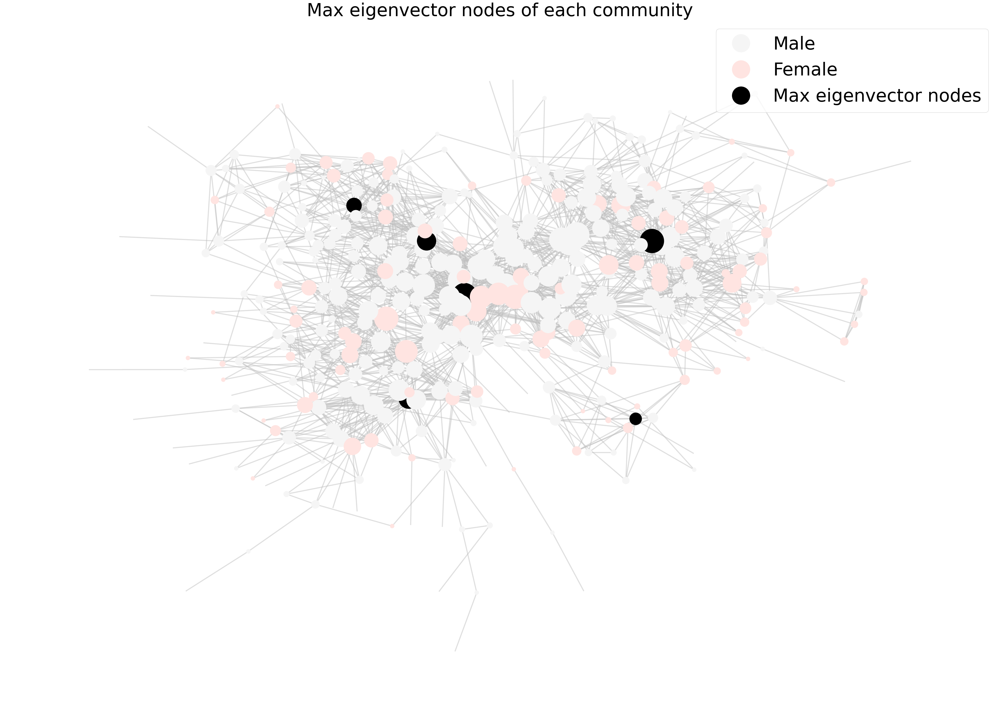

In [107]:
#Create a temporary gender value, for color mapping purposes
for node in list_max_eigenvector_nodes:
    J.nodes[node]['gender'] = 2

# Choose layout
pos = nx.kamada_kawai_layout(J)

# Define the colors for each gender
gender_colors = {0: 'whitesmoke', 1: 'mistyrose', 2:'black'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J, pos, node_size=[v for v in degrees],
                      node_color=[node_color_map.get(str(n)) for n in J.nodes()])

# Draw the edges
nx.draw_networkx_edges(J, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female', 'Max eigenvector nodes'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Max eigenvector nodes of each community', fontsize=50)
plt.show()
#plt.savefig('scientists_network_connected.png')

# Restore the previous genders of the nodes
for node in list_max_eigenvector_nodes:
    J.nodes[node]['gender'] = 0

<p style="font-family: Times New Roman;font-size:18px;color:navy"><b>5.6.3. Highest betweenness centrality for each community.</b></p>

In [108]:
graphs = [J1, J2, J3, J4, J5, J6]
graph_names = ["J1", "J2", "J3", "J4", "J5", "J6"]
betweenness_centralities = {}

for i, J in enumerate(graphs):
    betweenness = nx.betweenness_centrality(J)
    betweenness_centralities[f"J{i+1}"] = betweenness
    
max_betweenness_nodes = []
for i, J in enumerate(graphs):
    betweenness = nx.betweenness_centrality(J)
    max_betweenness = max(betweenness.values())
    nodes_with_max_betweenness = [node for node, centrality in betweenness.items() if centrality == max_betweenness]
    max_betweenness_nodes.append(nodes_with_max_betweenness)
    print(f"Node(s) in {graph_names[i]} with highest betweenness centrality: {nodes_with_max_betweenness}")

Node(s) in J1 with highest betweenness centrality: [12923]
Node(s) in J2 with highest betweenness centrality: [36853]
Node(s) in J3 with highest betweenness centrality: [7453]
Node(s) in J4 with highest betweenness centrality: [7454]
Node(s) in J5 with highest betweenness centrality: [43120]
Node(s) in J6 with highest betweenness centrality: [7463]


In [109]:
nodes_df = pd.read_csv("nodes_cluster_G.csv", delimiter=';', header=0)
edges_df = pd.read_csv('edges_cluster_G.csv', delimiter=';', header=0)
G = nx.Graph()
for _, row in nodes_df.iterrows():
    G.add_node(row['id'], coord=row['coord'], core=row['core'], gender=row['gender'])
for _, row in edges_df.iterrows():
    G.add_edge(row['source'], row['target'], pre_link=row['pre_link'], post_link=row['post_link'])
components = list(nx.connected_components(G))
largest_component = max(components, key=len)
J = G.subgraph(largest_component).copy()

In [110]:
gender_list_betweenness = []
for node_list in max_betweenness_nodes:
    for node in node_list:
        gender = J.nodes[node]['gender']
        if gender == 0:
            gender_list_betweenness.append("Male")
        elif gender == 1:
            gender_list_betweenness.append("Female")
        
print('What gender are the nodes with maximum betweenness centrality in their community?',gender_list_betweenness)
print (max_betweenness_nodes)
list_max_betweenness_nodes = [item for sublist in max_betweenness_nodes for item in sublist]

What gender are the nodes with maximum betweenness centrality in their community? ['Male', 'Male', 'Female', 'Male', 'Male', 'Female']
[[12923], [36853], [7453], [7454], [43120], [7463]]


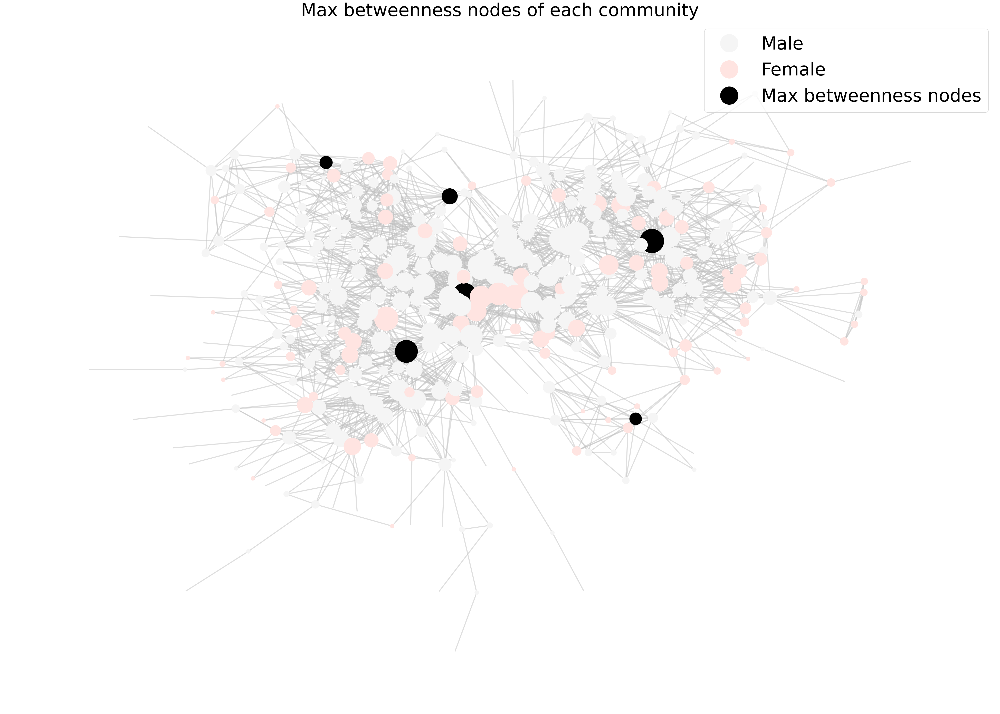

In [111]:
#Create a temporary gender value, for color mapping purposes
for node in list_max_betweenness_nodes:
    J.nodes[node]['gender'] = 2

# Choose layout
pos = nx.kamada_kawai_layout(J)

# Define the colors for each gender
gender_colors = {0: 'whitesmoke', 1: 'mistyrose', 2:'black'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in J.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in J.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(J, pos, node_size=[v for v in degrees],
                      node_color=[node_color_map.get(str(n)) for n in J.nodes()])

# Draw the edges
nx.draw_networkx_edges(J, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female', 'Max betweenness nodes'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Max betweenness nodes of each community', fontsize=50)
plt.show()
#plt.savefig('scientists_network_connected.png')

In [112]:
# Restore the previous genders of the nodes by reuploading graph J
nodes_df = pd.read_csv("nodes_cluster_G.csv", delimiter=';', header=0)
edges_df = pd.read_csv('edges_cluster_G.csv', delimiter=';', header=0)
G = nx.Graph()
for _, row in nodes_df.iterrows():
    G.add_node(row['id'], coord=row['coord'], core=row['core'], gender=row['gender'])
for _, row in edges_df.iterrows():
    G.add_edge(row['source'], row['target'], pre_link=row['pre_link'], post_link=row['post_link'])
components = list(nx.connected_components(G))
largest_component = max(components, key=len)
J = G.subgraph(largest_component).copy()

<p style="font-family: Times New Roman;font-size:22px;color:orangered"><b>6. Other findings</b></p>

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>6.1. The node more central than the coordinator.</b></p>

<p style="font-family: Times New Roman;font-size:16px;color:black"><b style="font-size:18px;color: navy;">Insight</b>: The cluster coordinator (7440) doesn't have the maximum centrality of Community 2. Instead node 36853, another male, has the maximum closeness, eigenvector and betweenness centrality in Community 2.</p>

In [113]:
closeness_centrality = nx.closeness_centrality(G)
closeness_centrality_36853 = closeness_centrality[36853]
print("Closeness centrality of the coordinator:", closeness_centrality_36853)

eigenvector_centrality = nx.eigenvector_centrality(G)
eigenvector_centrality_36853 = eigenvector_centrality[36853]
print("Eigenvector centrality of the coordinator:", eigenvector_centrality_36853)

betweenness_centrality = nx.betweenness_centrality(G)
betweenness_centrality_36853 = betweenness_centrality[36853]
print("Betweenness centrality of the coordinator:", betweenness_centrality_36853)

Closeness centrality of the coordinator: 0.3523288309268747
Eigenvector centrality of the coordinator: 0.20584336415300478
Betweenness centrality of the coordinator: 0.027174827353175276


In [148]:
# Change the color of coordinator node
nx.set_node_attributes(G, {36853: 'darkorange'}, name='color')

print('The degree of coordinator node is:',G.degree[36853])

neighbors_36853 = list(G.neighbors(36853))

# Create a subgraph with node 7440 and its neighbors
CN = G.subgraph([36853] + neighbors_36853)

# Check if the graph is connected or disconnected
print("Is the graph connected?", nx.is_connected(CN))

The degree of coordinator node is: 38
Is the graph connected? True


In [149]:
print("Neighbors of node 36853:", neighbors_36853)

Neighbors of node 36853: [7409, 7410, 7431, 7434, 7437, 7440, 7441, 7442, 7444, 7445, 7447, 8295, 8909, 9933, 9955, 36830, 36838, 36840, 36842, 36859, 61474, 36860, 36854, 40071, 54370, 85068, 36888, 54372, 36885, 60017, 40069, 73243, 36887, 43553, 111607, 66473, 73983, 36889]


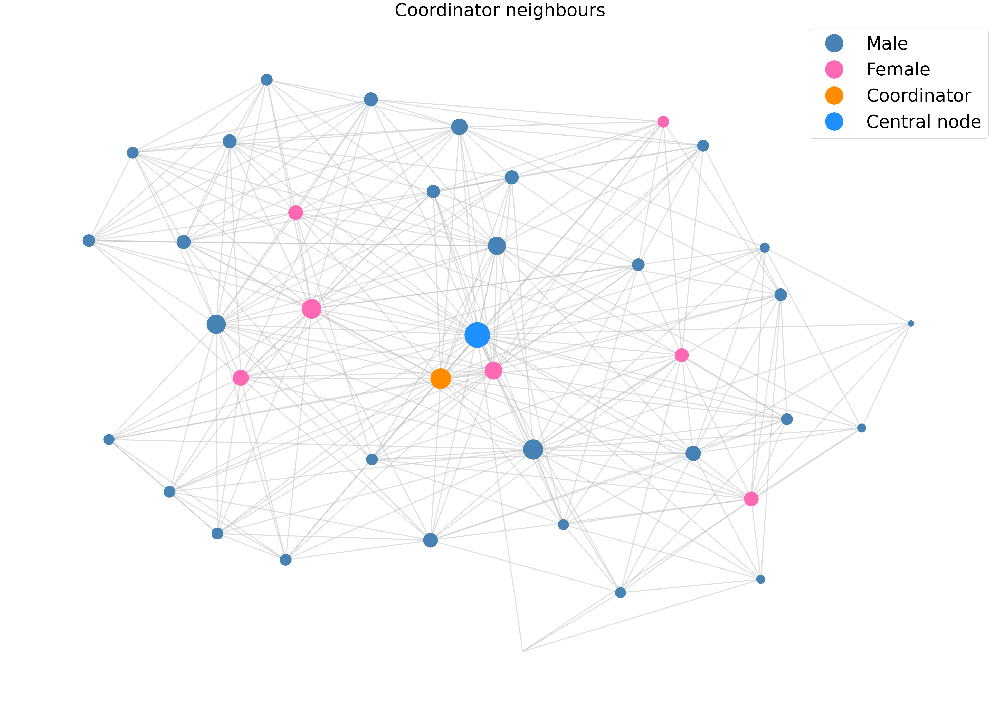

In [156]:
#Create a temporary gender value, for color mapping purposes
G.nodes[7440]['gender'] = 2
G.nodes[36853]['gender'] = 3

# Choose layout
pos = nx.kamada_kawai_layout(CN)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink', 2:'darkorange', 3:'dodgerblue'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in CN.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in CN.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(CN, pos, node_size=[v for v in degrees],
                      node_color=[node_color_map.get(str(n)) for n in CN.nodes()])

# Draw the edges
nx.draw_networkx_edges(CN, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female', 'Coordinator', 'Central node'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Coordinator neighbours', fontsize=50)
plt.show()
#plt.savefig('scientists_network_connected.png')

# Restore node 7440 and 36853 manhood
G.nodes[7440]['gender'] = 0
G.nodes[36853]['gender'] = 0

<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>6.2.The most central node in the graph.</b></p>

In [172]:
# compute the centrality for each node
closeness_centrality = nx.closeness_centrality(G)
eigenvector_centralities = nx.eigenvector_centrality(G)
betweenness_centralities = nx.betweenness_centrality(G)

#find the node with the highest centrality score
most_central_closeness_node = max(closeness_centrality, key=closeness_centrality.get)
print ('The most central closeness node is:',most_central_closeness_node)
most_central_eigenvector_node = max(eigenvector_centralities, key=eigenvector_centralities.get)
print ('The most central eigenvector node is:',most_central_eigenvector_node)
most_central_betweenness_node = max(betweenness_centralities, key=betweenness_centralities.get)
print ('The most central betweenness node is:',most_central_betweenness_node)

#Print their community and gender
for community, nodes in communities.items():
    if 7444 in nodes:
        node_7444 = nodes_df[nodes_df['id'] == 7444]
        gender_7444 = node_7444['gender'].values[0]
        print(f"Node 7444 is in Community {community} and has {'male' if gender_7444 == 0 else 'female'} gender.")

for community, nodes in communities.items():
    if 36853 in nodes:
        node_36853 = nodes_df[nodes_df['id'] == 36853]
        gender_36853 = node_36853['gender'].values[0]
        print(f"Node 36853 is in Community {community} and has {'male' if gender_36853 == 0 else 'female'} gender.")

The most central closeness node is: 7444
The most central eigenvector node is: 7444
The most central betweenness node is: 36889
Node 7444 is in Community 2 and has male gender.
Node 36853 is in Community 2 and has male gender.


<p style="font-family: Times New Roman;font-size:20px;color:navy"><b>6.3. Scientists identified as « core » members of the cluster.</b></p>

In [114]:
# Find nodes with attribute core=1
nodes_core = [n for n, attrs in G.nodes(data=True) if attrs['core'] == 1]

# Create a subgraph with only the nodes that have coord=1
C = G.subgraph(nodes_core)

# Print graph summary
print('Graph with', C.number_of_nodes(), 'nodes and', C.number_of_edges(), 'edges.')

# Check if the graph is connected or disconnected
print('Is the graph connected?', nx.is_connected(C))

Graph with 103 nodes and 623 edges.
Is the graph connected? False


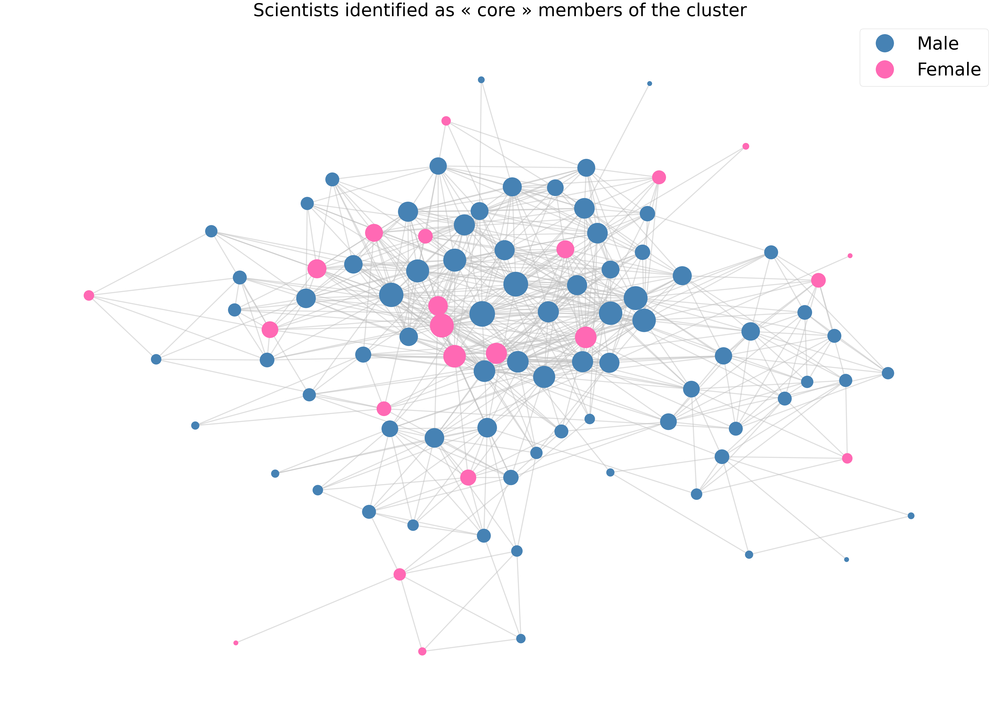

In [115]:
# Choose layout
pos = nx.kamada_kawai_layout(C)

# Define the colors for each gender
gender_colors = {0: 'steelblue', 1: 'hotpink'}

# Define a node color mapping dictionary based on the 'gender' attribute
node_color_map = {str(node_id): gender_colors[attr['gender']] for node_id, attr in C.nodes(data=True)}

# Get the degree list 
degrees = [d for n,d in C.degree()]
degree_min = min(degrees)
degree_max = max(degrees)
degrees = [(d-degree_min)/(degree_max - degree_min)*5000 for d in degrees]

# Draw the nodes, sized to their degree 
nx.draw_networkx_nodes(C, pos, node_size=[v for v in degrees],
                       node_color=[node_color_map.get(str(n)) for n in C.nodes()])

# Draw the edges
nx.draw_networkx_edges(C, pos, edge_color='silver', width=3.0, alpha=0.5)

# Add legend
legend_handles = [plt.plot([], [], marker='o', markersize=50, color=color, ls="")[0] for gender, color in gender_colors.items()]
plt.legend(handles=legend_handles, labels=['Male', 'Female'], loc='upper right', fontsize=50)

plt.rcParams['figure.figsize'] = [50, 35]

# Set the axis to be off
plt.axis('off')
plt.title('Scientists identified as « core » members of the cluster', fontsize=50)
plt.show()
#plt.savefig('scientists_network_connected.png')